In [3]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt 
import matplotlib as mpl
import matplotlib.gridspec as gridspec 
import mirnylib.plotting
import glob

# import pyarrow as pa
# import pyarrow.parquet
# import bbi

import pypairix as ppx
import cooler
import cooltools
import cooltools.snipping as snipping
# from cooltools.expected import contact_areas
from cooltools.lib import numutils
# import bioframe
# from bioframe.io import resources
# from bioframe.tools import bedtools, tsv

import new_scalings
from collections import defaultdict

import scipy.sparse as sp
from scipy.interpolate import interp1d
import DNA_info

import multiprocess as mp
from dask.array.chunk import coarsen

import scipy.ndimage.filters as filters
import scipy.ndimage as ndimage
from scipy.signal import argrelmax

from mirnylib.numutils import iterativeCorrection

%matplotlib notebook

In [8]:
from IPython.core.display import display, HTML
display(HTML("<style>.container { width: 100% !important; }</style>"))

# Functions to extracts and process pairs level pileup

In [2]:
class SaneParquet:
    def __init__(self, filepath, columns=None, **kwargs):
        self.f = pa.parquet.ParquetFile(filepath, **kwargs)
        self.columns = columns
        self.row_groups = [self.f.metadata.row_group(i) 
                               for i in range(self.f.metadata.num_row_groups)]
        self.index = pd.DataFrame(([
                rg.column(1).statistics.min.strip(), 
                rg.column(3).statistics.min.strip(), 
                rg.column(2).statistics.min, 
                rg.column(2).statistics.max
            ] for rg in self.row_groups),
            columns=['chrom1', 'chrom2', 'pos1.min', 'pos1.max'])
        
        self.index['chrom1'] =self.index['chrom1'].str.decode('utf-8')
        self.index['chrom2'] =self.index['chrom2'].str.decode('utf-8')
        
        # row groups happen to be chromosome blocks in this case, so we can do this
        self.blocks = defaultdict(list)
        for ix, row in self.index.iterrows():
            self.blocks[row.chrom1, row.chrom2].append(ix)
            if row.chrom1 != row.chrom2:
                self.blocks[row.chrom2, row.chrom1].append(ix)
    
    def __getitem__(self, key):
        return pd.concat(
            (self.f.read_row_group(rg, columns=self.columns).to_pandas() 
                for rg in self.blocks[key]),
            axis=0)




In [3]:
class PairsSnipper:
    
    def __init__(self, filepath, chromsizes, strands=None):
        self.filepath = filepath
#         self.columns = ['chrom1', 'chrom2', 'pos1', 'pos2', 'strand1', 'strand2']
        self.strands = strands
        self.chromsizes = chromsizes
    
    def select(self, region1, region2):
        print(region1, region2)
        chrom1, start1, end1 = region1
        chrom2, start2, end2 = region2
        
        columns = ['chrom1', 'chrom2', 'pos1', 'pos2', 'strand1', 'strand2', 'pair_type']
        pairq = SaneParquet(self.filepath, columns)
        df = pairq[chrom1, chrom2]
        if self.strands is not None:
            idx_s = (df.strand1 == self.strands[0]) & (df.strand2 == self.strands[1])
            df = df[idx_s]
            
        m, n = self.chromsizes[chrom1], self.chromsizes[chrom2]
        matrix = sp.csr_matrix((
            np.ones(len(df), dtype=int), 
            (df['pos1'].values, df['pos2'].values)
        ), (m, n))
        del df
        return matrix
    

    def snip(self, data, region1, region2, tup):

        s1, e1, s2, e2 = tup
        if s1 > s2:
            s1, s2 = s2, s1
            e1, e2 = e2, e1

        matrix = data
        m, n = matrix.shape
        dm, dn = e1 - s1, e2 - s2
        assert e1 >= 0
        assert e2 >= 0

        out_of_bounds = False
        pad_left = pad_right = pad_bottom = pad_top = None
        if s1 < 0:
            pad_bottom = -s1
            out_of_bounds = True
        if s2 < 0:
            pad_left = -s2
            out_of_bounds = True
        if e1 > m:
            pad_top = dm - (e1 - m)
            out_of_bounds = True
        if e2 > n:
            pad_right = dn - (e2 - n)
            out_of_bounds = True

        if out_of_bounds:        
            i0 = max(s1, 0)
            i1 = min(e1, m)
            j0 = max(s2, 0)
            j1 = min(e2, n)
            snippet = sp.csr_matrix((dm, dn))
        else:
            snippet = matrix[s1:e1, s2:e2]
        return snippet
    


In [7]:
def pair_ctcf(ctcf, genome, distance_array, distance_range, motif_orient):
    
    chromsizes = bioframe.fetch_chromsizes(genome)
    chromsizes = [(chrom, 0, chromsizes[chrom]) for chrom in chromsizes.index.values]
    ctcf = ctcf.reset_index()
    ctcf = snipping.assign_regions(ctcf, chromsizes)
    ctcf['region'] = ctcf.apply(lambda x: x['region']+','+str(x['index']), axis=1)
    ctcf = ctcf.set_index('region')

    all_pairs = []
    for distance in distance_array:
        print(f'Pairing sites from distance: {distance}')

        paired_ctcf = snipping.pair_sites(ctcf, distance, distance_range)
        mask = np.ones(paired_ctcf.shape[0]).astype(bool)
        mask = mask & (paired_ctcf.snip_strand_r == motif_orient[0])
        mask = mask & (paired_ctcf.snip_strand_l == motif_orient[1])
        paired_ctcf = paired_ctcf[mask]
        
        paired_ctcf[['site_id_r','index_r']] = paired_ctcf['site_id_r'].apply(
            lambda x: pd.Series(x.split(',')))
        paired_ctcf['index_r'] = paired_ctcf['index_r'].astype(int)
        paired_ctcf[['site_id_l','index_l']] = paired_ctcf['site_id_l'].apply(
            lambda x: pd.Series(x.split(',')))
        paired_ctcf['index_l'] = paired_ctcf['index_l'].astype(int)
        paired_ctcf = paired_ctcf[paired_ctcf.site_id_r == paired_ctcf.site_id_l]
        assert np.all(paired_ctcf.chrom_r == paired_ctcf.chrom_l)
        
        paired_ctcf = paired_ctcf[['chrom_r','snip_mid_r','index_r','chrom_l','snip_mid_l','index_l']]
        paired_ctcf = paired_ctcf.rename(columns=
                       {col:col[0:col.rfind('_')]+'1' if col[-1]=='r' 
                        else col[0:col.rfind('_')]+'2' for col in paired_ctcf.columns })

        all_pairs.append(paired_ctcf)

    all_pairs = pd.concat(all_pairs)
    all_pairs = all_pairs.drop_duplicates().sort_values(['chrom1','snip_mid1','chrom2','snip_mid2'])
    all_pairs = all_pairs.reset_index(drop=True)

    pair_left = all_pairs[['chrom1','index1']].rename(columns={'index1':'index'})
    pair_left = pair_left.merge(ctcf, on='index', how='left')
    del pair_left['chrom1']
    del pair_left['index']
    pair_left = pair_left.rename(columns={col:f'{col}1' for col in pair_left.columns})

    pair_right = all_pairs[['chrom2','index2']].rename(columns={'index2':'index'})
    pair_right = pair_right.merge(ctcf, on='index', how='left')
    del pair_right['chrom2']
    del pair_right['index']
    pair_right = pair_right.rename(columns={col:f'{col}2' for col in pair_right.columns})

    assert pair_left.shape[0] == pair_right.shape[0]
    all_pairs = pair_left.merge(pair_right, left_index=True, right_index=True)
    
    return all_pairs

In [5]:
def extend_2d(X, ext, direc):
    assert X.ndim == 2
    X = sp.coo_matrix(X)
    Y = np.zeros(X.shape)
    
    X.row = X.row + ext if direc[0] == '+' else X.row - ext
    X.col = X.col + ext if direc[1] == '+' else X.col - ext
    
    good_rows = (X.row < X.shape[0]) & (X.row >= 0)
    good_cols = (X.col < X.shape[1]) & (X.col >= 0)
    
    X.row = X.row[good_rows & good_cols]
    X.col = X.col[good_rows & good_cols]
    X.data = X.data[good_rows & good_cols]
    
    return X.toarray()

In [6]:
def coarsen_and_slice(mat, factor, pad_bp):
    
    cmat = coarsen(np.sum, mat, axes={0:factor, 1:factor})
    
    c_cent = int(cmat.shape[0]/2)
    c_pad = int(np.ceil(pad_bp/factor))
    c_start = c_cent - c_pad
    c_end = c_cent + c_pad
    
    cmat = cmat[c_start:c_end+1, c_start:c_end+1]
    
    return cmat

# Off-Diagonal CTCF Pileups

## Generating List of Motifs that contains CTCF ChIPseq peaks 

In [ ]:
db = resources.EncodeClient('/net/levsha/scratch/encode', 'GRCh38')
mask = np.ones(db.meta.shape[0]).astype(bool)
mask = mask & (db.meta['Assay']=='ChIP-seq')
mask = mask & (db.meta['Biosample term name'] == 'H1-hESC')
mask = mask & (db.meta['Experiment target'] == 'CTCF-human')
mask = mask & (db.meta['File Status'] == 'released')
mask = mask & (db.meta['Biological replicate(s)'] == '1, 2')
mask = mask & (db.meta['Audit ERROR'].apply(lambda x: not isinstance(x, str)))
mask = mask & (db.meta['File format'] == 'bed narrowPeak')
df = db.meta[mask]

In [ ]:
for exp, group in df.groupby('Experiment accession'):
    print(exp)
    display(group)
    print(group['Output type'].unique())
    print(group['Audit WARNING'].unique())
    print(group['Audit INTERNAL_ACTION'].unique())
    print(group['Audit NOT_COMPLIANT'].unique(), '\n')

In [ ]:
ctcf_chip = pd.read_csv(db.fetch('ENCFF821AQO'), sep='\t',
                 names=['chrom', 'start', 'end', 'name', 'score','strand','signal','pvalue', 'qvalue','peak'],
                 index_col=False).sort_values(['chrom','start','end'])
ctcf_chip['peak_pos'] = ctcf_chip['start'] + ctcf_chip['peak']
ctcf_chip = ctcf_chip[ctcf_chip.chrom.apply(lambda x: not ('_' in x))]
ctcf_chip = ctcf_chip[['chrom','start', 'end', 'peak_pos', 'score', 'signal']].sort_values(['chrom','start','end'])
ctcf_chip = ctcf_chip.reset_index(drop=True)

motif_df = pd.read_csv('./tracks/ChIPseq/fimo_out/CTCF_motifs_nils.txt', sep='\t',
                      names=['chrom','start','end','name','score','strand'])
motif_df = motif_df.sort_values(['chrom', 'start', 'end']).reset_index(drop=True)

ctcf = bioframe.tools.intersect(ctcf_chip.copy(deep=True), motif_df.copy(deep=True), outer_join=True, suffixes=('_chip','_motif'))
ctcf = ctcf[['chrom_chip', 'start_chip', 'end_chip', 'peak_pos_chip','score_chip', 'signal_chip',
               'start_motif', 'end_motif', 'strand_motif', 'score_motif']].dropna()
ctcf['pos_motif'] = (ctcf['start_motif'] + ctcf['end_motif'])//2
ctcf = ctcf.rename(columns={'chrom_chip':'chrom', 'start_chip':'start', 'end_chip':'end',
                            'peak_pos_chip':'chip_peak_pos', 'score_chip':'chip_score', 'signal_chip':'chip_signal',
                            'start_motif':'motif_start', 'end_motif':'motif_end', 
                            'strand_motif':'strand', 'score_motif':'motif_score'})
idx = ctcf.groupby(['chrom', 'start', 'end'])['motif_score'].transform(max) == ctcf['motif_score']
ctcf = ctcf[idx].drop_duplicates(subset=['chrom','start','end'])
ctcf = ctcf[['chrom','motif_start','motif_end', 'chip_peak_pos','chip_score', 'chip_signal', 'strand']]
ctcf = ctcf.rename(columns={'motif_start':'start', 'motif_end':'end'})
ctcf  = ctcf.reset_index(drop=True)
ctcf

In [ ]:
files = ! ls /net/levsha/share/sameer/U54/microc/pairq/*ESC*DpnII*
files

## Pairing CTCF Sites by different Motif Orientations and Pileup 

In [ ]:
all_pairs

In [ ]:
savepath = '/net/levsha/share/sameer/U54/microc/pileups/pairs/ctcf/off_diagonal/'
arms = DNA_info.get_chromosome_arms('hg38', exclude=['chrX','chrY','chrM'])

sep_array = np.arange(100000, 1100000, 100000)
sep_range = 50000


for mot_orient in ['+-', '-+', '++', '--']:
    print(f'CTCF Motif Orientation: {mot_orient}\n')
    
    all_pairs = pair_ctcf(ctcf.copy(), 'hg38', sep_array, sep_range, mot_orient)
    
    chrom1 = all_pairs['chrom1'].values
    pos1 = (all_pairs['start1'].values + all_pairs['end1'].values)//2
    binned_df1 = snipping.make_bin_aligned_windows(1, chrom1, pos1, flank_bp=5000)
    
    chrom2 = all_pairs['chrom2'].values
    pos2 = (all_pairs['start2'].values + all_pairs['end2'].values)//2
    binned_df2 = snipping.make_bin_aligned_windows(1, chrom2, pos2, flank_bp=5000)
    
    binned_df1 = binned_df1[['chrom', 'start', 'end']].merge(binned_df2[['chrom', 'start', 'end']], 
                                                    left_index=True, right_index=True, suffixes=('1', '2'))

    features = snipping.assign_regions(binned_df1, arms).dropna()
    assert np.all(features['region'].apply(lambda x: isinstance(x, str)))
    all_pairs = all_pairs.loc[features.index.values]
    print(all_pairs.shape[0])
    print(all_pairs.chrom1.unique())
    all_pairs.to_csv(f'{savepath}motif_{mot_orient}/paired_ctcf.txt', sep='\t', header=True, index=False)
    
    chromsizes = bioframe.fetch_chromsizes('hg38')
    for orient in ['++','--','+-','-+']:
        print('\n'+orient)
        pile = sp.csr_matrix((10001, 10001))
        for file in files:
            print('\n'+file)
            snipper = PairsSnipper(file, chromsizes, strands=orient)

            with mp.Pool(10) as p:
                out = snipping.pileup(features, snipper.select, snipper.snip, map=p.map)

            S = sum(out.squeeze().tolist())
            pile += S

        savename = f'U54-ESC4DN-FA-DpnII-2017524__hg38_{orient}.npz'
        sp.save_npz(f'{savepath}motif_{mot_orient}/{savename}', pile)
        print(f'SAVED TO: {savepath}motif_{mot_orient}/{savename}\n')

## Visualizing

<IPython.core.display.Javascript object>


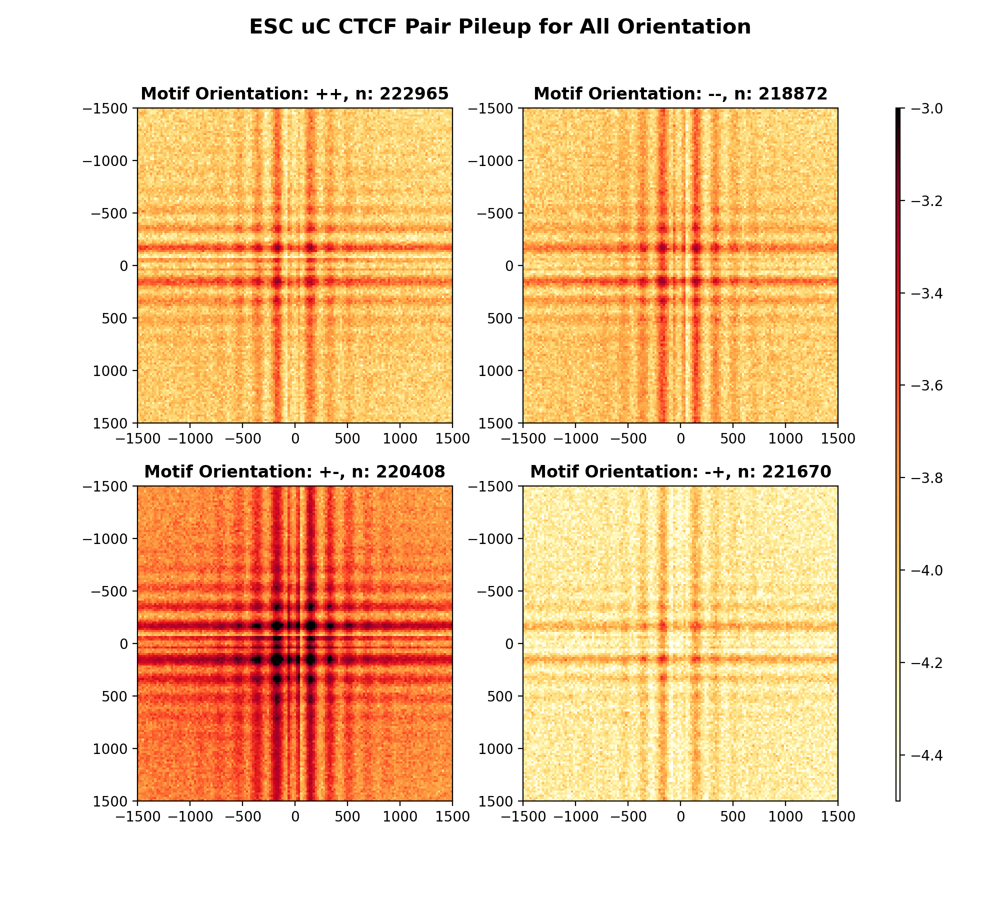


 /net/levsha/share/sameer/U54/microc/pileups/pairs/ctcf/off_diagonal/motif_++/
++
--
+-
-+
-3.149579607933018
-4.871115440167778

 /net/levsha/share/sameer/U54/microc/pileups/pairs/ctcf/off_diagonal/motif_--/
++
--
+-
-+
-3.1848541689485437
-4.641220202077586

 /net/levsha/share/sameer/U54/microc/pileups/pairs/ctcf/off_diagonal/motif_+-/
++
--
+-
-+
-2.7097588981791145
-4.388984844319376

 /net/levsha/share/sameer/U54/microc/pileups/pairs/ctcf/off_diagonal/motif_-+/
++
--
+-
-+
-3.4426169342864843
-5.044676925614447


In [53]:
# Displaying merged by orientations

factor = 20
pad_bp = 1500

name_dict = {'HiC':'U54-ESC4DN-FA-DpnII-2017524__hg38',
       'uC':'U54-H1ESC4DN-FA-DSG-MNase__hg38'}

lib = 'uC' 

gs = plt.GridSpec(nrows=2,ncols=3, width_ratios=[90, 90, 1])
fig = plt.figure(figsize=(10,9))
fig.suptitle(f'ESC {lib} CTCF Pair Pileup for All Orientation', fontweight='bold', fontsize=15)

for i, mot_orient in enumerate(['++','--','+-','-+']):
    path = f'/net/levsha/share/sameer/U54/microc/pileups/pairs/ctcf/off_diagonal/motif_{mot_orient}/'
    pair_list = pd.read_csv(f'{path}paired_ctcf.txt', sep='\t')
    print('\n', path)
    for j, orient in enumerate(['++','--','+-','-+']):
        print(orient)

        pu = sp.load_npz(path+f'{name_dict[lib]}_{orient}.npz')
        arr = pu[0:-1,0:-1].toarray()/pair_list.shape[0]

        arr = extend_2d(arr, 73, orient)

        if not j:
            tot = arr
        else:
            tot+= arr

    tot = coarsen_and_slice(tot, factor, pad_bp)
#     tot = iterativeCorrection(tot)[0]
    tot = np.log10(tot)
    
    print(np.nanmax(tot))
    print(np.nanmin(tot))

    r = i//2
    c = i%2
    
    ax = fig.add_subplot(gs[r,c])
    ax.set_title(f'Motif Orientation: {mot_orient}, n: {pair_list.shape[0]}', fontweight='bold', fontsize=12)
    ax.grid([])

    img = ax.imshow(tot, cmap='fall', vmax=-3, vmin=-4.5, 
                   extent=[-pad_bp, pad_bp, pad_bp, -pad_bp])

cax = plt.subplot(gs[:,2])
plt.colorbar(img, cax=cax)
# savepath = '/home/sameer/Dropbox (MIT)/Research/U54_microc/draft_figs/review_plots/pairs_pileups/'
# fig.savefig(f'{savepath}off_diag_ctcf_esc_{lib.lower()}_by_motif_orientations.pdf', format='pdf')

In [ ]:
factor = 20
pad_bp = 1500

sub_tot = np.log10(coarsen_and_slice(tot, factor, pad_bp))
print(np.nanmax(sub_tot))
print(np.nanmin(sub_tot))

gs = plt.GridSpec(nrows=1,ncols=2, width_ratios=[90, 1])
fig = plt.figure()
ax = fig.add_subplot(gs[0])
fig.suptitle(f'ESC uC CTCF Pair Pileup \nConvergent Orientation (Coarsening Factor: {factor})', 
             fontweight='bold', fontsize=15)
ax.grid([])

img = ax.imshow(sub_tot, cmap='fall',# vmax=-3, vmin=-4, 
               extent=[-pad_bp, pad_bp, -pad_bp, pad_bp])

cax = plt.subplot(gs[1])
plt.colorbar(img, cax=cax)

plot_savepath = './draft_figs/pairs_pileup/off_diagonal_ctcf/'
# # fig.savefig(f'{plot_savepath}off_diag_ctcf_esc_uc.pdf', format='pdf')
# fig.savefig(f'{savepath}off_diag_ctcf_esc_hic_zoomed.pdf', format='pdf')

In [ ]:
# Displaying merged by distance

path = '/net/levsha/share/sameer/U54/microc/pileups/pairs/ctcf/off_diagonal/motif_+-/'
pair_list = pd.read_csv(f'{path}paired_ctcf.txt', sep='\t')

filename = 'U54-H1ESC4DN-FA-DSG-MNase__hg38'
# filename = 'U54-ESC4DN-FA-DpnII-2017524-R1__hg38'

arr_dict = {}
for i, orient in enumerate(['++','--','+-','-+']):
    print(orient)
    pu = sp.load_npz(path+f'{filename}_{orient}.npz')
    arr = pu[0:-1,0:-1].toarray()/pair_list.shape[0]    
    arr_dict[orient] = arr
    

In [ ]:
gs = plt.GridSpec(nrows=2,ncols=3, width_ratios=[50, 50, 1])
fig = plt.figure(figsize=(10,9))

factor = 20
pad_bp = 5000

fig.suptitle(f'ESC Micro-C CTCF Pair Pileup \nConvergent Orientation (Coarsening Factor: {factor})', 
             fontweight='bold', fontsize=15)

for i, orient in enumerate(['++','--','+-','-+']):
    print(orient)
    if not i:
        ax = fig.add_subplot(gs[0])
        ax1 = ax
    else:
        ax = fig.add_subplot(gs[i + i//2], sharex=ax1, sharey=ax1)
        
    tot = arr_dict[orient]
    tot = coarsen_and_slice(tot, factor, pad_bp)
    tot = iterativeCorrection(tot)[0]
    tot = np.log10(tot)
    
    print(np.nanmax(tot))
    print(np.nanmin(tot))
    img = ax.imshow(tot, cmap='fall', vmax=-3.5, vmin=-4.5,
                    extent=[-pad_bp, pad_bp, pad_bp, -pad_bp])
    ax.grid([])
    ax.set_xticks([-pad_bp, 0, pad_bp])
    ax.set_yticks([pad_bp, 0, -pad_bp])
    ax.set_title(f'Read Orientation: {orient}', fontweight='bold', fontsize=10)
    
cax = fig.add_subplot(gs[:, 2])
plt.colorbar(img, cax=cax)

# plot_savepath = '/home/sameer/Dropbox (MIT)/Research/U54_microc/draft_figs/pairs_pileup/off_diagonal_ctcf/'
# fig.savefig(f'{plot_savepath}off_diag_ctcf_esc_hic_orients.pdf', format='pdf')

# On-Diagonal CTCF Pileups

## Generating List of Motifs that contains CTCF ChIPseq peaks 

In [ ]:
ctcf_chip = pd.read_csv(db.fetch('ENCFF821AQO'), sep='\t',
                 names=['chrom', 'start', 'end', 'name', 'score','strand','signal','pvalue', 'qvalue','peak'],
                 index_col=False).sort_values(['chrom','start','end'])
ctcf_chip['peak_pos'] = ctcf_chip['start'] + ctcf_chip['peak']
ctcf_chip = ctcf_chip[ctcf_chip.chrom.apply(lambda x: not ('_' in x))]
ctcf_chip = ctcf_chip[['chrom','start', 'end', 'peak_pos', 'score', 'signal']].sort_values(['chrom','start','end'])
ctcf_chip = ctcf_chip.reset_index(drop=True)

motif_df = pd.read_csv('./tracks/ChIPseq/fimo_out/CTCF_motifs_nils.txt', sep='\t',
                      names=['chrom','start','end','name','score','strand'])
motif_df = motif_df.sort_values(['chrom', 'start', 'end']).reset_index(drop=True)

ctcf = bioframe.tools.intersect(ctcf_chip.copy(deep=True), motif_df.copy(deep=True), outer_join=True, suffixes=('_chip','_motif'))
ctcf = ctcf[['chrom_chip', 'start_chip', 'end_chip', 'peak_pos_chip','score_chip', 'signal_chip',
               'start_motif', 'end_motif', 'strand_motif', 'score_motif']].dropna()
ctcf['pos_motif'] = (ctcf['start_motif'] + ctcf['end_motif'])//2
ctcf = ctcf.rename(columns={'chrom_chip':'chrom', 'start_chip':'start', 'end_chip':'end',
                            'peak_pos_chip':'chip_peak_pos', 'score_chip':'chip_score', 'signal_chip':'chip_signal',
                            'start_motif':'motif_start', 'end_motif':'motif_end', 
                            'strand_motif':'strand', 'score_motif':'motif_score'})
idx = ctcf.groupby(['chrom', 'start', 'end'])['motif_score'].transform(max) == ctcf['motif_score']
ctcf = ctcf[idx].drop_duplicates(subset=['chrom','start','end'])
ctcf = ctcf[['chrom','motif_start','motif_end', 'chip_peak_pos','chip_score', 'chip_signal', 'strand']]
ctcf = ctcf.rename(columns={'motif_start':'start', 'motif_end':'end'})
ctcf  = ctcf.reset_index(drop=True)

chromsizes = bioframe.fetch_chromsizes('hg38')
chromsizes = [(chrom, 0, chromsizes[chrom]) for chrom in chromsizes.index.values]
ctcf = snipping.assign_regions(ctcf, chromsizes).dropna()
del ctcf['region']
ctcf

In [ ]:
files = ! ls /net/levsha/share/sameer/U54/microc/pairq/*ESC*MNase*
files

## Filtering by Motif Orientation and Piling up

In [ ]:
savepath = '/net/levsha/share/sameer/U54/microc/pileups/pairs/ctcf/on_diagonal/'
subfolders = ['downstream','upstream']

arms = DNA_info.get_chromosome_arms('hg38', exclude=['chrX','chrY','chrM'])

for i, motif_orient in enumerate(['+','-']):
    print(subfolders[i])
    filtered_ctcf = ctcf[ctcf.strand==motif_orient].reset_index(drop=True)
    chrom = filtered_ctcf.chrom.values
    pos = (filtered_ctcf.start.values + filtered_ctcf.end.values)//2
    binned_df = snipping.make_bin_aligned_windows(1, chrom, pos, flank_bp=5000)

    features = snipping.assign_regions(binned_df, arms).dropna()
    assert np.all(features['region'].apply(lambda x: isinstance(x, str)))
    filtered_ctcf = filtered_ctcf.loc[features.index.values]

    filtered_ctcf.to_csv(f'{savepath}motif_{subfolders[i]}/ctcf_sites.txt', sep='\t', header=True, index=False)
    
    
    chromsizes = bioframe.fetch_chromsizes('hg38')
    for orient in ['++','--','+-','-+']:
        print('\n'+orient)
        pile = sp.csr_matrix((10001, 10001))
        for file in files:
            print('\n'+file)
            snipper = PairsSnipper(file, chromsizes, strands=orient)

            with mp.Pool(10) as p:
                out = snipping.pileup(features, snipper.select, snipper.snip, map=p.map)

            S = sum(out.squeeze().tolist())
            pile += S

        savename = f'U54-H1ESC4DN-FA-DSG-MNase__hg38_{orient}.npz'
        sp.save_npz(f'{savepath}motif_{subfolders[i]}/{savename}', pile)
        print(f'SAVED TO: {savepath}motif_{subfolders[i]}/{savename}')

## Visualizing

In [ ]:
! ls /net/levsha/share/sameer/U54/microc/pileups/pairs/ctcf/on_diagonal/motif_downstream/

In [54]:
# Displaying merged by orientations

filename = 'U54-H1ESC4DN-FA-DSG-MNase__hg38'
# filename = 'U54-ESC4DN-FA-DpnII-2017524-R1__hg38'

arr_dict = {}
for folder in ['downstream', 'upstream']:
    print('\n',folder)
    
    path = f'/net/levsha/share/sameer/U54/microc/pileups/pairs/ctcf/on_diagonal/motif_{folder}/'
    site_list = pd.read_csv(f'{path}ctcf_sites.txt', sep='\t')
    
    for i, orient in enumerate(['++','--','+-','-+']):
#         orient = '+-'
        print(orient)

        pu = sp.load_npz(path+f'{filename}_{orient}.npz')
        arr = pu[0:-1,0:-1].toarray()/site_list.shape[0]


#         arr = extend_2d(arr, 73, orient)
        arr = arr + arr.T

        if not i:
            tot = arr
        else:
            tot+= arr
        break
    arr_dict[folder] = tot


 downstream
++

 upstream
++


<IPython.core.display.Javascript object>


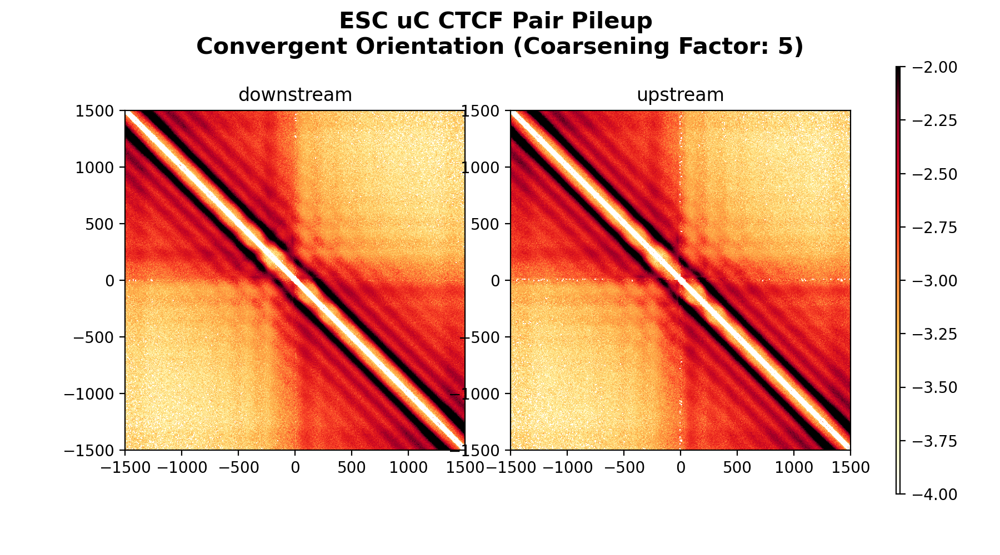

Hi
-1.5569161286632727
-inf


/home/sameer/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:19: RuntimeWarning: divide by zero encountered in log10


Hi
-1.5984415592383467
-inf


In [58]:
factor = 5
pad_bp = 1500

gs = plt.GridSpec(nrows=1,ncols=3, width_ratios=[90, 90, 1])
fig = plt.figure(figsize=(9,5))

fig.suptitle(f'ESC uC CTCF Pair Pileup \nConvergent Orientation (Coarsening Factor: {factor})', 
             fontweight='bold', fontsize=15)
for i, folder in enumerate(['downstream', 'upstream']):
    
    ax = fig.add_subplot(gs[i])
    ax.set_title(folder)
    ax.grid([])
    
    tot = arr_dict[folder]
    sub_tot = coarsen_and_slice(tot, factor, pad_bp)

    sub_tot = iterativeCorrection(sub_tot)[0]
    sub_tot = np.log10(sub_tot)
    
    print(np.nanmax(sub_tot))
    print(np.nanmin(sub_tot))

    img = ax.imshow(sub_tot, cmap='fall', vmax=-2, vmin=-4, 
                   extent=[-pad_bp, pad_bp, -pad_bp, pad_bp])

cax = plt.subplot(gs[2])
plt.colorbar(img, cax=cax)

plot_savepath = './draft_figs/pairs_pileup/off_diagonal_ctcf/'
# # fig.savefig(f'{plot_savepath}off_diag_ctcf_esc_uc.pdf', format='pdf')
# fig.savefig(f'{savepath}off_diag_ctcf_esc_hic_zoomed.pdf', format='pdf')

## Subtract upstream from downstream

In [ ]:
factor = 20
pad_bp = 1500

gs = plt.GridSpec(nrows=1,ncols=2, width_ratios=[90, 1])
fig = plt.figure()

fig.suptitle(f'ESC uC CTCF Pair Pileup \nConvergent Orientation (Coarsening Factor: {factor})', 
             fontweight='bold', fontsize=15)
# for i, folder in enumerate(['downstream', 'upstream']):
    
ax = fig.add_subplot(gs[0])
ax.grid([])

up_tot = arr_dict['upstream']
up_tot = coarsen_and_slice(up_tot, factor, pad_bp)

down_tot = arr_dict['downstream']
down_tot = coarsen_and_slice(down_tot, factor, pad_bp)

diff  = up_tot - down_tot
print(np.nanmin(diff), np.nanmax(diff))
img = ax.imshow(diff, cmap='coolwarm', vmax=0.05, vmin=-0.05, 
               extent=[-pad_bp, pad_bp, -pad_bp, pad_bp])

cax = plt.subplot(gs[1])
plt.colorbar(img, cax=cax)

## Rotate upstream from 180 degrees and subtract from downstream

In [ ]:
factor = 20
pad_bp = 1500

gs = plt.GridSpec(nrows=1,ncols=2, width_ratios=[90, 1])
fig = plt.figure()

fig.suptitle(f'ESC uC CTCF Pair Pileup \nConvergent Orientation (Coarsening Factor: {factor})', 
             fontweight='bold', fontsize=15)
# for i, folder in enumerate(['downstream', 'upstream']):
    
ax = fig.add_subplot(gs[0])
ax.grid([])

up_tot = arr_dict['upstream']
up_tot = coarsen_and_slice(up_tot, factor, pad_bp)
up_tot = np.rot90(up_tot, k=-2)

down_tot = arr_dict['downstream']
down_tot = coarsen_and_slice(down_tot, factor, pad_bp)

diff  = up_tot - down_tot
print(np.nanmin(diff), np.nanmax(diff))
img = ax.imshow(diff, cmap='coolwarm', vmax=1, vmin=-1, 
               extent=[-pad_bp, pad_bp, -pad_bp, pad_bp])

cax = plt.subplot(gs[1])
plt.colorbar(img, cax=cax)

In [ ]:
# Displaying merged by orientations
# subfolder = 'downstream'
# path = f'/net/levsha/share/sameer/U54/microc/pileups/pairs/ctcf/on_diagonal/motif_{subfolder}/'
# site_list = pd.read_csv(f'{path}ctcf_sites.txt', sep='\t')

filename = 'U54-H1ESC4DN-FA-DSG-MNase__hg38'
# filename = 'U54-ESC4DN-FA-DpnII-2017524-R1__hg38'

arr_dict = {}
for folder in ['downstream', 'upstream']:
    print('\n',folder)
    
    path = f'/net/levsha/share/sameer/U54/microc/pileups/pairs/ctcf/on_diagonal/motif_{folder}/'
    site_list = pd.read_csv(f'{path}ctcf_sites.txt', sep='\t')
    
    arr_dict[folder] = {}
    for i, orient in enumerate(['++','--','+-','-+']):
        print(orient)

        pu = sp.load_npz(path+f'{filename}_{orient}.npz')
        arr = pu[0:-1,0:-1].toarray()/site_list.shape[0]
        
        arr = arr + arr.T
        arr_dict[folder][orient] = arr

In [ ]:
factor = 20
pad_bp = 1500

gs = plt.GridSpec(nrows=1,ncols=3, width_ratios=[90, 90, 1])
fig = plt.figure()

fig.suptitle(f'ESC uC CTCF Pair Pileup \nConvergent Orientation (Coarsening Factor: {factor})', 
             fontweight='bold', fontsize=15)
for i, folder in enumerate(['downstream', 'upstream']):
    
    ax = fig.add_subplot(gs[i])
    ax.set_title(folder)
    ax.grid([])
    
    tot = arr_dict[folder]
    sub_tot = np.log10(coarsen_and_slice(tot, factor, pad_bp))
    
    print(np.nanmax(sub_tot))
    print(np.nanmin(sub_tot))

    img = ax.imshow(sub_tot, cmap='fall', vmax=0, vmin=-2, 
                   extent=[-pad_bp, pad_bp, -pad_bp, pad_bp])

cax = plt.subplot(gs[2])
plt.colorbar(img, cax=cax)

plot_savepath = './draft_figs/pairs_pileup/off_diagonal_ctcf/'
# # fig.savefig(f'{plot_savepath}off_diag_ctcf_esc_uc.pdf', format='pdf')
# fig.savefig(f'{savepath}off_diag_ctcf_esc_hic_zoomed.pdf', format='pdf')

# Gene Start Pileups based on H3K4me3

## H3K4me3 ChIP-seq from ENCODE

In [ ]:
db = resources.EncodeClient('/net/levsha/scratch/encode', 'GRCh38')
mask = np.ones(db.meta.shape[0]).astype(bool)
mask = mask & (db.meta['Assay']=='ChIP-seq')
mask = mask & (db.meta['Biosample term name'] == 'H1-hESC')
mask = mask & (db.meta['Experiment target'] == 'H3K4me3-human')
mask = mask & (db.meta['File Status'] == 'released')
mask = mask & (db.meta['Biological replicate(s)'] == '1, 2')
mask = mask & (db.meta['Audit ERROR'].apply(lambda x: not isinstance(x, str)))
mask = mask & (db.meta['Experiment accession'] == 'ENCSR814XPE')
mask = mask & (db.meta['Output type'] == 'replicated peaks')
mask = mask & (db.meta['File format'] == 'bed narrowPeak')
df = db.meta[mask]
df

In [ ]:
h3k4me3_peaks = pd.read_csv(db.fetch('ENCFF456NIF'), sep='\t',
                            names=['chrom', 'start', 'end', 'name', 'score','strand','signal','pvalue', 'qvalue','peak'],
                            index_col=False
                           ).sort_values(['chrom','start','end']).reset_index(drop=True).reset_index()
h3k4me3_peaks = h3k4me3_peaks[['chrom','start','end','signal','peak', 'index']]

## Intersecting H3K4me3 peaks with RNA-seq

In [ ]:
! ls /net/wiz/home/sameer/RNAseq/genome_index/

In [ ]:
esc1 = pd.read_csv('/net/wiz/home/sameer/RNAseq/ENCODE_ENCSR000COU/H1ESC-T1/rsem/H1ESC_T1.genes.results', 
                   sep='\t')
esc1 = esc1[['gene_id','TPM']]
esc2 = pd.read_csv('/net/wiz/home/sameer/RNAseq/ENCODE_ENCSR000COU/H1ESC-T2/rsem/H1ESC_T2.genes.results', 
                   sep='\t')
esc2 = esc2[['gene_id','TPM']]

esc = esc1.merge(esc2, on='gene_id', how='outer', suffixes=('1','2'))
esc['TPM'] = (esc['TPM1'] + esc['TPM2'])/2
esc['gene_id'] = esc['gene_id'].apply(lambda x: x.split('_')[0])

In [ ]:
path = '/net/wiz/home/sameer/RNAseq/genome_index/Homo_sapiens.GRCh38.82.chr.gtf'
gene_locations = pd.read_csv(path, sep='\t', skiprows=5,
                            names=['chrom','source','feature_type','start','end','misc1','orient','misc2','name'])
gene_locations = gene_locations[gene_locations.feature_type == 'gene']
gene_locations = gene_locations[['chrom','start','end','orient','name']]
gene_locations[['gene_id','name']] = gene_locations['name'].apply(lambda s: pd.Series(
                                                                        np.asarray(s.split('; '))[[0,2]]))
gene_locations['name'] = gene_locations['name'].apply(lambda x: x.split('"')[1])
gene_locations['gene_id'] = gene_locations['gene_id'].apply(lambda x: x.split('"')[1])
gene_locations['chrom'] = gene_locations['chrom'].astype(str).apply(lambda s: 'chr'+s if s != 'MT' else 'chrM')

In [ ]:
esc = gene_locations.merge(esc[['gene_id', 'TPM']], on='gene_id', how='outer')
del esc['gene_id']
esc

In [ ]:
with tsv(h3k4me3_peaks) as a, tsv(esc) as b: 
        h3k4me3_rnaseq = bedtools.intersect(a=a.name, b=b.name, wa=True, wb=True)
        h3k4me3_rnaseq.columns = ([col+'_k4me3' for col in h3k4me3_peaks.columns] + 
                        [col+'_rnaseq' for col in esc.columns])

In [ ]:
h3k4me3_rnaseq

In [ ]:
# df1 = h3k4me3_genes[h3k4me3_genes.orient_genes=='+']
# df2 = h3k4me3_genes[h3k4me3_genes.orient_genes=='-']
# mask1 = np.abs(df1.start_k4me3.values - df1.start_genes.values) > 3000
# mask2 = np.abs(df2.end_k4me3.values - df2.end_genes.values) > 3000

# h3k4me3_genes = pd.concat([df1, df2])

In [ ]:
h3k4me3_rnaseq = h3k4me3_rnaseq[['chrom_k4me3', 'start_k4me3','end_k4me3','signal_k4me3','peak_k4me3',
                               'index_k4me3', 'orient_rnaseq', 'name_rnaseq', 'TPM_rnaseq']]
h3k4me3_rnaseq = h3k4me3_rnaseq.rename(columns={'chrom_k4me3':'chrom', 'start_k4me3':'start','end_k4me3':'end',
                                          'signal_k4me3':'signal','peak_k4me3':'peak', 'index_k4me3':'index', 
                                          'orient_rnaseq':'gene_orients', 'name_rnaseq':'gene_names',
                                             'TPM_rnaseq':'TPM'})
h3k4me3_rnaseq = h3k4me3_rnaseq.sort_values(['chrom','start','end']).reset_index(drop=True)
h3k4me3_rnaseq

## DNase-seq from ENCODE

In [ ]:
db = resources.EncodeClient('/net/levsha/scratch/encode', 'GRCh38')
mask = np.ones(db.meta.shape[0]).astype(bool)
mask = mask & (db.meta['Assay']=='DNase-seq')
mask = mask & (db.meta['Biosample term name'] == 'H1-hESC')
mask = mask & (db.meta['File Status'] == 'released')
mask = mask & (db.meta['Experiment accession'] == 'ENCSR794OFW')
# mask = mask & (db.meta['File format'] == 'bed narrowPeak')
df  = db.meta[mask]
df

In [ ]:
dnase_peaks = pd.read_csv(db.fetch('ENCFF905XDS'), sep='\t',
                            names=['chrom', 'start', 'end', 'name', 'score','strand','signal','pvalue', 'qvalue','peak'],
                            index_col=False
                           ).sort_values(['chrom','start','end']).reset_index(drop=True).reset_index()
dnase_peaks = dnase_peaks[['chrom','start','end','signal','peak', 'index']]

# CTCF ChIP-seq

In [ ]:
ctcf_peaks = pd.read_csv(db.fetch('ENCFF821AQO'), sep='\t',
                            names=['chrom', 'start', 'end', 'name', 'score','strand','signal','pvalue', 'qvalue','peak'],
                            index_col=False
                           ).sort_values(['chrom','start','end']).reset_index(drop=True).reset_index()
ctcf_peaks = ctcf_peaks[['chrom','start','end','signal','peak', 'index']]

## Intersecting DHS peaks with CTCF peaks and subtracting from all DHS peaks

In [ ]:
with tsv(dnase_peaks) as a, tsv(ctcf_peaks) as b: 
        peak_int1 = bedtools.intersect(a=a.name, b=b.name, wa=True, wb=True)
        peak_int1.columns = ([col+'_dhs' for col in dnase_peaks.columns] + 
                        [col+'_ctcf' for col in ctcf_peaks.columns])

In [ ]:
ctcf_indices = peak_int1['index_dhs'].unique()
all_indices = dnase_peaks['index'].values
dnase_peaks2 = dnase_peaks.loc[~np.isin(all_indices, ctcf_indices)]
del dnase_peaks2['index']
dnase_peaks2 = dnase_peaks2.reset_index(drop=True).reset_index()
dnase_peaks2 = dnase_peaks2[['chrom','start','end','signal','peak','index']]

In [ ]:
dnase_peaks2.shape

## Intersecting CTCF less - DNase peaks with H3K4me3 peaks

In [ ]:
with tsv(h3k4me3_rnaseq) as a, tsv(dnase_peaks2) as b: 
        peak_int2 = bedtools.intersect(a=a.name, b=b.name, wa=True, wb=True)
        peak_int2.columns = ([col+'_k4me3' for col in h3k4me3_rnaseq.columns] + 
                       [col+'_dhs' for col in dnase_peaks2.columns])
idx = peak_int2.groupby(['chrom_k4me3', 'start_k4me3', 'end_k4me3'])['signal_dhs'].transform(max) == peak_int2['signal_dhs']
peak_int2 = peak_int2[idx].reset_index(drop=True)
peak_int2

In [ ]:
k4me3_dnase_peaks = peak_int2[['chrom_dhs','start_dhs','end_dhs','signal_dhs','peak_dhs',
                               'signal_k4me3', 'gene_orients_k4me3', 'gene_names_k4me3', 'TPM_k4me3']]
k4me3_dhs_peaks = k4me3_dnase_peaks.rename(columns={'chrom_dhs':'chrom',
                                                    'start_dhs':'start',
                                                    'end_dhs':'end',
                                                    'peak_dhs':'peak',
                                                    'signal_dhs':'dhs_signal',
                                                    'signal_k4me3':'k4me3_signal',
                                                    'gene_orients_k4me3':'gene_orients', 
                                                    'gene_names_k4me3':'gene_names',
                                                    'TPM_k4me3':'TPM'
                                                    })
k4me3_dhs_peaks['TPM'] = k4me3_dhs_peaks['TPM'].astype(float)

In [ ]:
files = ! ls /net/levsha/share/sameer/U54/microc/pairq/*ESC*MNase*
files

In [ ]:
# Displaying merged by orientations

filename = 'U54-H1ESC4DN-FA-DSG-MNase__hg38'
# filename = 'U54-ESC4DN-FA-DpnII-2017524-R1__hg38'

arr_dict = {}
for folder in ['downstream', 'upstream']:
    print('\n',folder)
    
    path = f'/net/levsha/share/sameer/U54/microc/pileups/pairs/h3k4me3/gene_{folder}/'
    site_list = pd.read_csv(f'{path}k4me3_proximal_dhs_sites.txt', sep='\t')
    
    for i, orient in enumerate(['++','--','+-','-+']):
        print(orient)

        pu = sp.load_npz(path+f'{filename}_{orient}.npz')
        arr = pu[0:-1,0:-1].toarray()/site_list.shape[0]


        arr = extend_2d(arr, 73, orient)
        arr = arr + arr.T

        if not i:
            tot = arr
        else:
            tot+= arr

    arr_dict[folder] = tot


In [ ]:
factor = 5
pad_bp = 1500
save_dir = '/home/sameer/Dropbox (MIT)/Research/U54_microc/draft_figs/review_plots/pairs_pileups/'
for i, folder in enumerate(['Downstream', 'Upstream']):
        
    gs = plt.GridSpec(nrows=1,ncols=2, width_ratios=[90, 1])
    fig = plt.figure(figsize=(7,7))

    fig.suptitle(f'ESC uC H3K4me3 Pair Pileup \n for {folder} Genes (All Orientations)', 
                 fontweight='bold', fontsize=15)
    ax = fig.add_subplot(gs[0])
#     ax.set_title(folder)
    ax.grid([])
    
    tot = arr_dict[folder.lower()]
    sub_tot = np.log10(coarsen_and_slice(tot, factor, pad_bp))
    
    print(np.nanmax(sub_tot))
    print(np.nanmin(sub_tot))

    img = ax.imshow(sub_tot, cmap='fall', vmax=-1, vmin=-3, 
                   extent=[-pad_bp, pad_bp, pad_bp, -pad_bp])

    cax = plt.subplot(gs[1])
    plt.colorbar(img, cax=cax)
    fig.savefig(f'{save_dir}TSS_esc_uc_{folder.lower()}.pdf', format='pdf')

In [ ]:
# Displaying merged by orientations

filename = 'U54-H1ESC4DN-FA-DSG-MNase__hg38'
# filename = 'U54-ESC4DN-FA-DpnII-2017524-R1__hg38'

arr_dict = {}
for folder in ['downstream', 'upstream']:
    print('\n',folder)
    
    path = f'/net/levsha/share/sameer/U54/microc/pileups/pairs/h3k4me3/gene_{folder}/'
    site_list = pd.read_csv(f'{path}k4me3_proximal_dhs_sites.txt', sep='\t')
    
    arr_dict[folder] = {}
    for i, orient in enumerate(['++','--','+-','-+']):
        print(orient)

        pu = sp.load_npz(path+f'{filename}_{orient}.npz')
        arr = pu[0:-1,0:-1].toarray()/site_list.shape[0]


#         arr = extend_2d(arr, 73, orient)
        arr = arr + arr.T
        arr_dict[folder][orient] = arr


In [ ]:
factor = 5
pad_bp = 1500

for folder in ['Downstream', 'Upstream']:
    gs = plt.GridSpec(nrows=2,ncols=3, width_ratios=[90, 90, 1])
    fig = plt.figure(figsize=(10,9))

    fig.suptitle(f'ESC uC H3K4me3 Pair Pileup for {folder} Genes\n by Read Orientation', 
                 fontweight='bold', fontsize=15)

    for i, orient in enumerate(['++','--','+-','-+']):  

        tot = arr_dict[folder.lower()][orient]
        sub_tot = np.log10(coarsen_and_slice(tot, factor, pad_bp))

        print(np.nanmax(sub_tot))
        print(np.nanmin(sub_tot))

        r = i//2
        c = i%2

        ax = fig.add_subplot(gs[r, c])
        ax.set_title(f'Read Orientation: {orient}', fontweight='bold')
        ax.grid([])

        img = ax.imshow(sub_tot, cmap='fall', vmax=-1.5, vmin=-4, 
                       extent=[-pad_bp, pad_bp, pad_bp, -pad_bp])

    cax = plt.subplot(gs[:,2])
    plt.colorbar(img, cax=cax)
    
    fig.savefig(f'{save_dir}TSS_esc_uc_{folder.lower()}_orient.pdf', format='pdf')

## Filtering by Gene Orientation and Expression Levels, then Piling up

In [ ]:
savepath = '/net/levsha/share/sameer/U54/microc/pileups/pairs/h3k4me3/'
subfolders = ['downstream','upstream']

arms = DNA_info.get_chromosome_arms('hg38', exclude=['chrX','chrY','chrM'])

qlims = np.round(np.quantile(k4me3_dhs_peaks.TPM.values, [0,0.25,0.5,0.75,1]),2)
qlims = list(zip(qlims[0:-1], qlims[1:]))

for i, gene_orient in enumerate(['+','-']):
    print(subfolders[i])
    
    filtered_h3k4me3 = k4me3_dhs_peaks[k4me3_dhs_peaks.gene_orients==gene_orient].reset_index(drop=True)
    
    for l, u in qlims:
        print(f'TPM levels: {l}-{u}')
        df = filtered_h3k4me3[(filtered_h3k4me3.TPM >= l) & (filtered_h3k4me3.TPM < u)]
        chrom = df.chrom.values
        pos = (df.start.values + df.peak.values)

        binned_df = snipping.make_bin_aligned_windows(1, chrom, pos, flank_bp=5000)
        features = snipping.assign_regions(binned_df, arms).dropna()
        assert np.all(features['region'].apply(lambda x: isinstance(x, str)))

        df = df.loc[features.index.values]
        df.to_csv(f'{savepath}gene_{subfolders[i]}/by_expression_level/k4me3_dhs_sites_{l}-{u}TPM.txt', 
                  sep='\t', header=True, index=False)
    
    
        chromsizes = bioframe.fetch_chromsizes('hg38')
        for orient in ['++','--','+-','-+']:
            print('\n'+orient)
            pile = sp.csr_matrix((10001, 10001))
            for file in files:
                print('\n'+file)
                snipper = PairsSnipper(file, chromsizes, strands=orient)

                with mp.Pool(10) as p:
                    out = snipping.pileup(features, snipper.select, snipper.snip, map=p.map)

                S = sum(out.squeeze().tolist())
                pile += S

            savename = f'U54-H1ESC4DN-FA-DSG-MNase__hg38_{orient}_{l}-{u}TPM.npz'
            sp.save_npz(f'{savepath}gene_{subfolders[i]}/by_expression_level/{savename}', pile)
            print(f'SAVED TO: {savepath}gene_{subfolders[i]}/by_expression_level/{savename}')

In [ ]:
# Displaying merged by orientations

filename = 'U54-H1ESC4DN-FA-DSG-MNase__hg38'
# filename = 'U54-ESC4DN-FA-DpnII-2017524-R1__hg38'

qlims = np.round(np.quantile(k4me3_dhs_peaks.TPM.values, [0,0.25,0.5,0.75,1]),2)
qlims = list(zip(qlims[0:-1], qlims[1:]))

arr_dict = {}
for folder in ['downstream', 'upstream']:
    print('\n',folder)
    
    arr_dict[folder] = {}
    
    for l, u in qlims:
        print(l, u)
        path = f'/net/levsha/share/sameer/U54/microc/pileups/pairs/h3k4me3/gene_{folder}/by_expression_level/'
        site_list = pd.read_csv(f'{path}k4me3_dhs_sites_{l}-{u}TPM.txt', sep='\t')

        for i, orient in enumerate(['++','--','+-','-+']):
            print(orient)

            pu = sp.load_npz(path+f'{filename}_{orient}_{l}-{u}TPM.npz')
            arr = pu[0:-1,0:-1].toarray()/site_list.shape[0]


            arr = extend_2d(arr, 73, orient)
            arr = arr + arr.T

            if not i:
                tot = arr
            else:
                tot+= arr

        arr_dict[folder][f'{l} - {u} TPM'] = tot


In [ ]:
factor = 5
pad_bp = 1500

for folder in ['Downstream', 'Upstream']:
    gs = plt.GridSpec(nrows=2,ncols=3, width_ratios=[90, 90, 1])
    fig = plt.figure(figsize=(10,9))

    fig.suptitle(f'ESC uC H3K4me3 Pair Pileup for {folder} Genes\n by Expression Level', 
                 fontweight='bold', fontsize=15)
    
    for i, (l, u) in enumerate(qlims):
        exp = f'{l} - {u} TPM'
        tot = arr_dict[folder.lower()][exp]
        sub_tot = np.log10(coarsen_and_slice(tot, factor, pad_bp))
    #     print(sub_tot)
        print(np.nanmax(sub_tot))
        print(np.nanmin(sub_tot))

        r = i//2
        c = i%2
        ax = fig.add_subplot(gs[r, c])
    #     ax.axhline(0, color='k')
    #     ax.axvline(0, color='k')
        ax.set_title(exp, fontweight='bold')
        ax.grid([])

        img = ax.imshow(sub_tot, cmap='fall', vmax=-1, vmin=-3, 
                       extent=[-pad_bp, pad_bp, pad_bp, -pad_bp])

    cax = plt.subplot(gs[:, 2])
    plt.colorbar(img, cax=cax)
    
    fig.savefig(f'{save_dir}TSS_esc_uc_{folder.lower()}_expression_lvl.pdf', format='pdf')

# TSS from CAGE-seq

## CAGE-seq from ENCODE

In [ ]:
tss_peaks = pd.read_csv(db.fetch('ENCFF038OTF'), sep='\t',
                            names=['chrom', 'start', 'end', 'name', 'score','strand',
                                   'pLocalIDR','pGlobalIDR', 
                                   'rep1_start','rep1_end','rep1_fc',
                                   'rep2_start','rep2_end','rep2_fc',
                                  ],
                            index_col=False
                           ).sort_values(['chrom','start','end']).reset_index(drop=True).reset_index()
tss_peaks['fc'] = (tss_peaks['rep1_fc'] + tss_peaks['rep1_fc'])/2
tss_peaks = tss_peaks[['chrom','start','end','fc','strand', 'index']]
tss_peaks[tss_peaks.strand=='+'].to_csv('~/h1esc_cageseq_plus_strand_peaks.bed', 
                                        sep='\t', header=False, index=False)

In [ ]:
bioframe.fetch_chromsizes('hg38').to_csv('~/hg38.chromsizes.txt', sep='\t', header=False, index=True)

# CTCF ChIP-seq

In [ ]:
flank = 5000
ctcf_peaks = pd.read_csv(db.fetch('ENCFF821AQO'), sep='\t',
                            names=['chrom', 'start', 'end', 'name', 'score','strand','signal','pvalue', 'qvalue','peak'],
                            index_col=False
                           ).sort_values(['chrom','start','end']).reset_index(drop=True).reset_index()
ctcf_peaks = ctcf_peaks[['chrom','start','end','signal','peak', 'index']]
ctcf_peaks['start'] = ctcf_peaks['start'].apply(lambda x: x-flank if (x-flank) > 0 else 0)
ctcf_peaks['end'] = ctcf_peaks['end'].apply(lambda x: x+flank)
ctcf_peaks

## Intersecting CAGE-seq with CTCF peaks and takign the complement

In [ ]:
with tsv(tss_peaks) as a, tsv(ctcf_peaks) as b: 
        tss_no_ctcf = bedtools.intersect(a=a.name, b=b.name, wa=True, v=True)
        tss_no_ctcf.columns = tss_peaks.columns
tss_no_ctcf

# Piling up

In [ ]:
files = ! ls /net/levsha/share/sameer/U54/microc/pairq/*ESC*MNase*
files

In [ ]:
savepath = '/net/levsha/share/sameer/U54/microc/pileups/pairs/cageseq/'
subfolders = ['downstream','upstream']

arms = DNA_info.get_chromosome_arms('hg38', exclude=['chrX','chrY','chrM'])

for i, gene_orient in enumerate(['+','-']):
    print(subfolders[i])
    
    df = tss_no_ctcf[tss_no_ctcf.strand==gene_orient].reset_index(drop=True)
    chrom = df.chrom.values
    pos = (df.start.values + df.end.values)//2

    binned_df = snipping.make_bin_aligned_windows(1, chrom, pos, flank_bp=5000)
    features = snipping.assign_regions(binned_df, arms).dropna()
    assert np.all(features['region'].apply(lambda x: isinstance(x, str)))

    df = df.loc[features.index.values]
    os.makedirs(f'{savepath}gene_{subfolders[i]}', exist_ok=True)
    df.to_csv(f'{savepath}gene_{subfolders[i]}/cage_sites.txt', 
              sep='\t', header=True, index=False)


    chromsizes = bioframe.fetch_chromsizes('hg38')
    for orient in ['++','--','+-','-+']:
        print('\n'+orient)
        pile = sp.csr_matrix((10001, 10001))
        for file in files:
            print('\n'+file)
            snipper = PairsSnipper(file, chromsizes, strands=orient)

            with mp.Pool(10) as p:
                out = snipping.pileup(features, snipper.select, snipper.snip, map=p.map)

            S = sum(out.squeeze().tolist())
            pile += S

        savename = f'U54-H1ESC4DN-FA-DSG-MNase__hg38_{orient}.npz'
        sp.save_npz(f'{savepath}gene_{subfolders[i]}/{savename}', pile)
        print(f'SAVED TO: {savepath}gene_{subfolders[i]}/{savename}')

In [ ]:
# Displaying merged by orientations

filename = 'U54-H1ESC4DN-FA-DSG-MNase__hg38'
# filename = 'U54-ESC4DN-FA-DpnII-2017524-R1__hg38'

arr_dict = {}
for folder in ['downstream', 'upstream']:
    print('\n',folder)
    
    path = f'/net/levsha/share/sameer/U54/microc/pileups/pairs/cageseq/gene_{folder}/'
    site_list = pd.read_csv(f'{path}cage_sites.txt', sep='\t')
    
    for i, orient in enumerate(['++','--','+-','-+']):
        print(orient)

        pu = sp.load_npz(path+f'{filename}_{orient}.npz')
        arr = pu[0:-1,0:-1].toarray()/site_list.shape[0]


        arr = extend_2d(arr, 73, orient)
        arr = arr + arr.T

        if not i:
            tot = arr
        else:
            tot+= arr

    arr_dict[folder] = tot


In [ ]:
factor = 5
pad_bp = 1500
save_dir = '/home/sameer/Dropbox (MIT)/Research/U54_microc/draft_figs/review_plots/pairs_pileups/'
for i, folder in enumerate(['Downstream', 'Upstream']):
        
    gs = plt.GridSpec(nrows=1,ncols=2, width_ratios=[90, 1])
    fig = plt.figure(figsize=(7,7))

    fig.suptitle(f'ESC uC TSS (CAGE-seq) Pair Pileup \n for {folder} Genes (All Orientations)', 
                 fontweight='bold', fontsize=15)
    ax = fig.add_subplot(gs[0])
#     ax.set_title(folder)
    ax.grid([])
    
    tot = arr_dict[folder.lower()]
    sub_tot = np.log10(coarsen_and_slice(tot, factor, pad_bp))
    
    print(np.nanmax(sub_tot))
    print(np.nanmin(sub_tot))

    img = ax.imshow(sub_tot, cmap='fall', vmax=-1, vmin=-3, 
                   extent=[-pad_bp, pad_bp, pad_bp, -pad_bp])

    cax = plt.subplot(gs[1])
    plt.colorbar(img, cax=cax)
    fig.savefig(f'{save_dir}TSS_esc_uc_{folder.lower()}.pdf', format='pdf')

In [ ]:
# Displaying merged by orientations

filename = 'U54-H1ESC4DN-FA-DSG-MNase__hg38'
# filename = 'U54-ESC4DN-FA-DpnII-2017524-R1__hg38'

arr_dict = {}
for folder in ['downstream', 'upstream']:
    print('\n',folder)
    
    path = f'/net/levsha/share/sameer/U54/microc/pileups/pairs/cageseq/gene_{folder}/'
    site_list = pd.read_csv(f'{path}cage_sites.txt', sep='\t')
    
    arr_dict[folder] = {}
    for i, orient in enumerate(['++','--','+-','-+']):
        print(orient)

        pu = sp.load_npz(path+f'{filename}_{orient}.npz')
        arr = pu[0:-1,0:-1].toarray()/site_list.shape[0]

        arr = arr + arr.T
        arr_dict[folder][orient] = arr


In [ ]:
factor = 5
pad_bp = 1500

for folder in ['Downstream', 'Upstream']:
    gs = plt.GridSpec(nrows=2,ncols=3, width_ratios=[90, 90, 1])
    fig = plt.figure(figsize=(10,9))

    fig.suptitle(f'ESC uC TSS (CAGE-seq) Pair Pileup for {folder} Genes\n by Read Orientation', 
                 fontweight='bold', fontsize=15)

    for i, orient in enumerate(['++','--','+-','-+']):  

        tot = arr_dict[folder.lower()][orient]
        sub_tot = np.log10(coarsen_and_slice(tot, factor, pad_bp))

        print(np.nanmax(sub_tot))
        print(np.nanmin(sub_tot))

        r = i//2
        c = i%2

        ax = fig.add_subplot(gs[r, c])
        ax.set_title(f'Read Orientation: {orient}', fontweight='bold')
        ax.grid([])

        img = ax.imshow(sub_tot, cmap='fall', vmax=-1.5, vmin=-4, 
                       extent=[-pad_bp, pad_bp, pad_bp, -pad_bp])

    cax = plt.subplot(gs[:,2])
    plt.colorbar(img, cax=cax)
    
    fig.savefig(f'{save_dir}TSS_esc_uc_{folder.lower()}_orient.pdf', format='pdf')

## Filtering by Gene Orientation and Expression Levels, then Piling up

In [ ]:
savepath = '/net/levsha/share/sameer/U54/microc/pileups/pairs/cageseq/'
subfolders = ['downstream','upstream']

arms = DNA_info.get_chromosome_arms('hg38', exclude=['chrX','chrY','chrM'])

qlims = np.round(np.quantile(peak_int.fc.values, [0,0.33,0.67,1]),2)
qlims = list(zip(qlims[0:-1], qlims[1:]))

for i, gene_orient in enumerate(['+','-']):
    if gene_orient == '+':
        continue
        
    print(subfolders[i])
    
    df = tss_no_ctcf[tss_no_ctcf.strand==gene_orient].reset_index(drop=True)

    for l, u in qlims:
        print(f'Fold Change Range: {l}-{u}')
        filtered_df = df[(df.fc >= l) & (df.fc < u)]
        chrom = filtered_df.chrom.values
        pos = (filtered_df.start.values + filtered_df.end.values)//2

        binned_df = snipping.make_bin_aligned_windows(1, chrom, pos, flank_bp=5000)
        features = snipping.assign_regions(binned_df, arms).dropna()
        assert np.all(features['region'].apply(lambda x: isinstance(x, str)))

        df = df.loc[features.index.values]
        os.makedirs(f'{savepath}gene_{subfolders[i]}/by_expression_level/', exist_ok=True)
        df.to_csv(f'{savepath}gene_{subfolders[i]}/by_expression_level/cage_sites_{l}-{u}fold_change.txt', 
                  sep='\t', header=True, index=False)
    
    
        chromsizes = bioframe.fetch_chromsizes('hg38')
        for orient in ['++','--','+-','-+']:
            print('\n'+orient)
            pile = sp.csr_matrix((10001, 10001))
            for file in files:
                print('\n'+file)
                snipper = PairsSnipper(file, chromsizes, strands=orient)

                with mp.Pool(10) as p:
                    out = snipping.pileup(features, snipper.select, snipper.snip, map=p.map)

                S = sum(out.squeeze().tolist())
                pile += S

            savename = f'U54-H1ESC4DN-FA-DSG-MNase__hg38_{orient}_{l}-{u}fold_change.npz'
            sp.save_npz(f'{savepath}gene_{subfolders[i]}/by_expression_level/{savename}', pile)
            print(f'SAVED TO: {savepath}gene_{subfolders[i]}/by_expression_level/{savename}')

In [ ]:
# Displaying merged by orientations

filename = 'U54-H1ESC4DN-FA-DSG-MNase__hg38'
# filename = 'U54-ESC4DN-FA-DpnII-2017524-R1__hg38'

qlims = np.round(np.quantile(peak_int.fc.values, [0,0.33,0.67,1]),2)
qlims = list(zip(qlims[0:-1], qlims[1:]))

arr_dict = {}
for folder in ['downstream', 'upstream']:
    print('\n',folder)
    
    arr_dict[folder] = {}
    
    for l, u in qlims:
        print(l, u)
        path = f'/net/levsha/share/sameer/U54/microc/pileups/pairs/cageseq/gene_{folder}/by_expression_level/'
        site_list = pd.read_csv(f'{path}cage_sites_{l}-{u}fold_change.txt', sep='\t')

        for i, orient in enumerate(['++','--','+-','-+']):
            print(orient)

            pu = sp.load_npz(path+f'{filename}_{orient}_{l}-{u}fold_change.npz')
            arr = pu[0:-1,0:-1].toarray()/site_list.shape[0]


            arr = extend_2d(arr, 73, orient)
            arr = arr + arr.T

            if not i:
                tot = arr
            else:
                tot+= arr

        arr_dict[folder][f'{l} - {u}'] = tot

In [ ]:
factor = 5
pad_bp = 1500

for folder in ['Downstream', 'Upstream']:
    gs = plt.GridSpec(nrows=1,ncols=4, width_ratios=[90, 90, 90, 1])
    fig = plt.figure(figsize=(15,6))

    fig.suptitle(f'ESC uC TSS (CAGE-seq) Pair Pileup for {folder} Genes\n by Expression Level', 
                 fontweight='bold', fontsize=15)
    
    for i, (l, u) in enumerate(qlims):
        exp = f'{l} - {u}'
        tot = arr_dict[folder.lower()][exp]
        sub_tot = np.log10(coarsen_and_slice(tot, factor, pad_bp))
    #     print(sub_tot)
        print(np.nanmax(sub_tot))
        print(np.nanmin(sub_tot))


        ax = fig.add_subplot(gs[i])
    #     ax.axhline(0, color='k')
    #     ax.axvline(0, color='k')
        ax.set_title(f'Fold Change: {exp}', fontweight='bold')
        ax.grid([])

        img = ax.imshow(sub_tot, cmap='fall', vmax=-1, vmin=-3, 
                       extent=[-pad_bp, pad_bp, pad_bp, -pad_bp])

    cax = plt.subplot(gs[3])
    plt.colorbar(img, cax=cax)
    fig.tight_layout()
    fig.savefig(f'{save_dir}TSS_esc_uc_{folder.lower()}_expression_lvl.pdf', format='pdf')

# TSS Off Diagonal Pileups (CAGE-seq)

In [ ]:
distal_tss = tss_peaks.copy()#[tss_peaks.strand == gene_orient]
distal_tss = snipping.assign_regions(distal_tss, arms)
distal_tss['next_start'] = np.append(distal_tss['start'].values[1:], np.nan)
distal_tss['next_region'] = np.append(distal_tss['region'].values[1:], np.nan)
distal_tss['prev_start'] = np.append(np.nan, distal_tss['start'].values[0:-1])
distal_tss['prev_region'] = np.append(np.nan, distal_tss['region'].values[0:-1])

distal_tss = distal_tss[distal_tss['region'] == distal_tss['next_region']].dropna()
distal_tss = distal_tss[distal_tss['region'] == distal_tss['prev_region']].dropna()
distal_tss['distance_next'] = (distal_tss['next_start'] - distal_tss['start'])
distal_tss['distance_prev'] = (distal_tss['start'] - distal_tss['prev_start'])

print(distal_tss.shape[0])
distance =  distal_tss['distance_next'].values
assert np.all(distance > 0)

bins = cooltools.numutils.logbins(distance.min(), distance.max(), ratio=1.25)

fig, ax = plt.subplots()
ax.set_xscale('log')
ax.set_title('Histogram of distances to \nnext CAGE-seq TSS peak')
ax.set_ylabel('Counts')
ax.set_xlabel('Distance')
_ = ax.hist(distance, bins=bins)

distal_tss = distal_tss[(distal_tss.distance_next > 5000) & (distal_tss.distance_prev > 5000)]
distal_tss = distal_tss[['chrom','start','end','fc','strand']]

In [ ]:
files =! ls /net/levsha/share/sameer/U54/microc/pairq/*ESC*MNase*
files

In [ ]:
savepath = '/net/levsha/share/sameer/U54/microc/pileups/pairs/cageseq/off_diagonal/'
arms = DNA_info.get_chromosome_arms('hg38', exclude=['chrX','chrY','chrM'])

sep_array = np.arange(1000000, 11000000, 1000000)
sep_range = 1000000


for mot_orient in ['+-', '-+', '++', '--']:
    print(f'Gene Orientations: {mot_orient}\n')
    
    all_pairs = pair_ctcf(distal_tss.copy(), 'hg38', sep_array, sep_range, mot_orient)
    
    chrom1 = all_pairs['chrom1'].values
    pos1 = (all_pairs['start1'].values + all_pairs['end1'].values)//2
    binned_df1 = snipping.make_bin_aligned_windows(1, chrom1, pos1, flank_bp=5000)
    
    chrom2 = all_pairs['chrom2'].values
    pos2 = (all_pairs['start2'].values + all_pairs['end2'].values)//2
    binned_df2 = snipping.make_bin_aligned_windows(1, chrom2, pos2, flank_bp=5000)
    
    binned_df1 = binned_df1[['chrom', 'start', 'end']].merge(binned_df2[['chrom', 'start', 'end']], 
                                                    left_index=True, right_index=True, suffixes=('1', '2'))

    features = snipping.assign_regions(binned_df1, arms).dropna()
    assert np.all(features['region'].apply(lambda x: isinstance(x, str)))
    all_pairs = all_pairs.loc[features.index.values]

    os.makedirs(f'{savepath}gene_orient_{mot_orient}/', exist_ok=True)
    all_pairs.to_csv(f'{savepath}gene_orient_{mot_orient}/paired_tss.txt', sep='\t', header=True, index=False)
    
    chromsizes = bioframe.fetch_chromsizes('hg38')
    for orient in ['++','--','+-','-+']:
        print('\n'+orient)
        pile = sp.csr_matrix((10001, 10001))
        for file in files:
            print('\n'+file)
            snipper = PairsSnipper(file, chromsizes, strands=orient)

            with mp.Pool(10) as p:
                out = snipping.pileup(features, snipper.select, snipper.snip, map=p.map)

            S = sum(out.squeeze().tolist())
            pile += S

        savename = f'U54-H1ESC4DN-FA-DSG-MNase__hg38_{orient}.npz'
        sp.save_npz(f'{savepath}gene_orient_{mot_orient}/{savename}', pile)
        print(f'SAVED TO: {savepath}gene_orient_{mot_orient}/{savename}\n')

In [ ]:
pile.shape

In [ ]:
# Displaying merged by orientations

factor = 20
pad_bp = 1500

name_dict = {'HiC':'U54-ESC4DN-FA-DpnII-2017524__hg38',
       'uC':'U54-H1ESC4DN-FA-DSG-MNase__hg38'}

lib = 'uC' 

gs = plt.GridSpec(nrows=2,ncols=3, width_ratios=[90, 90, 1])
fig = plt.figure(figsize=(10,9))
fig.suptitle(f'ESC {lib} TSS (CAGE-seq) Pair Pileup for All Orientation', fontweight='bold', fontsize=15)

for i, mot_orient in enumerate(['++','--','+-','-+']):
    path = f'/net/levsha/share/sameer/U54/microc/pileups/pairs/cageseq/off_diagonal/gene_orient_{mot_orient}/'
    pair_list = pd.read_csv(f'{path}paired_tss.txt', sep='\t')
    print('\n', path)
    for j, orient in enumerate(['++','--','+-','-+']):
        print(orient)

        pu = sp.load_npz(path+f'{name_dict[lib]}_{orient}.npz')
        arr = pu[0:-1,0:-1].toarray()/pair_list.shape[0]

        arr = extend_2d(arr, 73, orient)

        if not j:
            tot = arr
        else:
            tot+= arr

    sub_tot = np.log10(coarsen_and_slice(tot, factor, pad_bp))
    subtot = iterativeCorrection(sub_tot)[0]
    print(np.nanmax(sub_tot))
    print(np.nanmin(sub_tot))

    r = i//2
    c = i%2
    
    ax = fig.add_subplot(gs[r,c])
    ax.set_title(f'Gene Orientation: {mot_orient}, n: {pair_list.shape[0]}', fontweight='bold', fontsize=12)
    ax.grid([])

    img = ax.imshow(sub_tot, cmap='fall', vmax=-3.5, vmin=-4.5, 
                   extent=[-pad_bp, pad_bp, pad_bp, -pad_bp])

cax = plt.subplot(gs[:,2])
plt.colorbar(img, cax=cax)
# savepath = '/home/sameer/Dropbox (MIT)/Research/U54_microc/draft_figs/review_plots/pairs_pileups/'
# fig.savefig(f'{savepath}off_diag_ctcf_esc_{lib.lower()}_by_motif_orientations.pdf', format='pdf')

# DHS intersected with motifs

In [ ]:
! ls /net/levsha/share/nezar/u54_uC/jaspar_core/dnase_with_motifs.hg38.H1-duke.jaspar2020_core_human.tsv

In [8]:
dhs_motif = pd.read_csv('/net/levsha/share/nezar/u54_uC/jaspar_core/dnase_with_motifs.hg38.H1-duke.jaspar2020_core_human.tsv',
           sep='\t', index_col=0)
dhs_motif['motif_name'] = dhs_motif['motif_name'].apply(lambda x: x[0:x.find('(var')] if x.find('(var') != -1 else x)

dhs_motif_reduced = []
for (chrom, start, end), group in dhs_motif.groupby(['chrom','start','end']):
    motifs = group.groupby('motif_name').agg({'motif_qval':'min'})
    qval = motifs['motif_qval'].min()
    dhs_motif_reduced.append(group[group.motif_qval==qval])
    
dhs_motif_reduced = pd.concat(dhs_motif_reduced)
display(dhs_motif_reduced)

,start,end,fc,motif_start,motif_end,matrix_id,motif_score,motif_strand,motif_pval,motif_qval,motif_seq,motif_name
chrom,,,,,,,,,,,,
chr1,181415,181565,69.0,181531,181543,MA0753.2,19.3864,-,1.960000e-07,0.0499,ACGCCCCCCCCAA,ZNF740
chr1,267981,268131,15.0,267999,268017,MA0139.1,16.4918,+,1.130000e-06,0.1710,GCAGCACCAGGTGGCAGCA,CTCF
chr1,778655,778805,249.0,778801,778819,MA0139.1,17.1475,-,7.640000e-07,0.1510,CGGCCACCAGTAGGCAGCG,CTCF
chr1,779135,779285,17.0,779188,779201,MA0814.2,16.5950,+,1.150000e-06,0.1690,CCCCCTGAGGCTGC,TFAP2C
chr1,827415,827565,150.0,827541,827551,MA1513.1,19.4510,-,1.940000e-07,0.0385,GCCCCGCCCCT,KLF15
...,...,...,...,...,...,...,...,...,...,...,...,...
chrY,26408676,26408826,13.0,26408695,26408707,MA0872.1,18.5082,-,3.250000e-07,0.1870,TGCCCCCGGGGGG,TFAP2A
chrY,26457840,26457990,7.0,26457958,26457971,MA0062.3,15.1884,-,2.690000e-06,0.2220,TCTACTTCCTGTCA,GABPA
chrY,26563057,26563207,10.0,26563178,26563196,MA0139.1,20.9672,+,5.620000e-08,0.0473,aagccagtagatggcgcca,CTCF


In [9]:
transcription_factors = np.sort(dhs_motif_reduced['motif_name'].unique())
reduced_tf_list = []
for tf in transcription_factors:
    df = dhs_motif_reduced[dhs_motif_reduced['motif_name']==tf]
    df = df[df['motif_qval'] <= 0.5]
    
    if len(df) < 1000:
        continue
    print(tf)
    reduced_tf_list.append(tf)
    
#     fig, ax = plt.subplots()
#     for orient in ['+','-']:
#         df1 = df[df['motif_strand'] == orient]
#         qvals = df1['motif_qval'].values
#         _ = ax.hist(qvals, bins=100, label=f'Number: {len(qvals)}', histtype='step')
#     ax.legend()
    
#     fig.savefig(f'/net/levsha/share/sameer/U54/microc/pileups/pairs/dhs_motifs/qval_distribution/{tf}.png')
#     plt.close(fig)

ASCL1
BHLHE22
CTCF
CTCFL
E2F6
EBF1
EBF3
EGR1
KLF15
KLF17
KLF4
KLF5
KLF9
MAZ
MYOG
MZF1
NFIB
NR2C2
PLAG1
PLAGL2
REST
RREB1
SP2
SP9
TCF4
TFAP2A
TFAP2C
THAP11
ZKSCAN5
ZNF148
ZNF16
ZNF263
ZNF682


ASCL1 



<IPython.core.display.Javascript object>


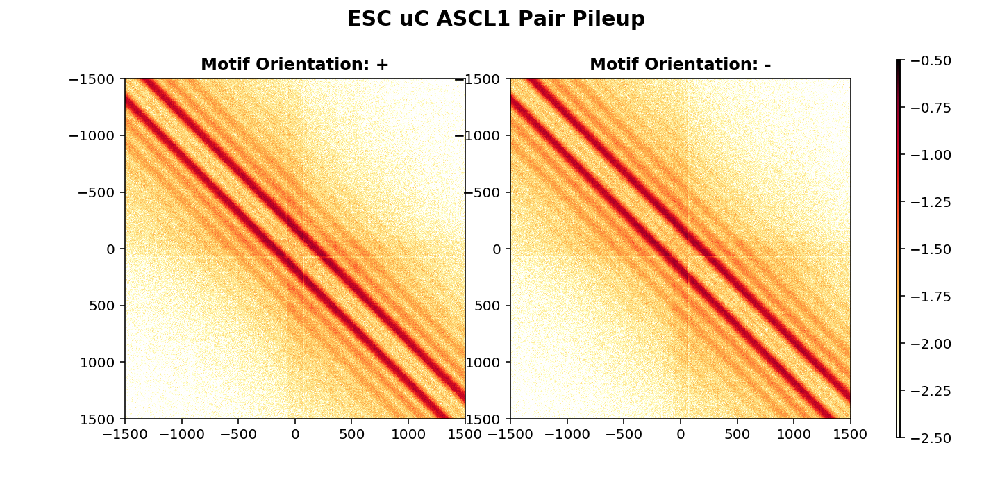

Motif Orientation: +

++
--
+-
-+


/home/sameer/miniconda3/lib/python3.6/site-packages/ipykernel_launcher.py:35: RuntimeWarning: divide by zero encountered in log10


-0.7167427482578472
-inf
Motif Orientation: -

++
--
+-
-+
-0.6553055032811875
-inf
BHLHE22 



/home/sameer/miniconda3/lib/python3.6/site-packages/ipykernel_launcher.py:48: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.


<IPython.core.display.Javascript object>


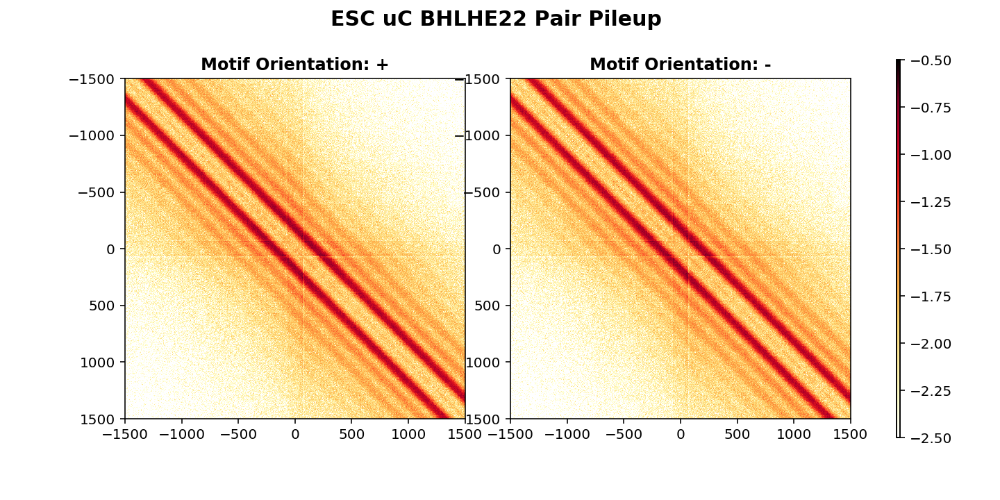

Motif Orientation: +

++
--
+-
-+
-0.655275674339117
-inf
Motif Orientation: -

++
--
+-
-+
-0.655275674339117
-inf
CTCF 



<IPython.core.display.Javascript object>


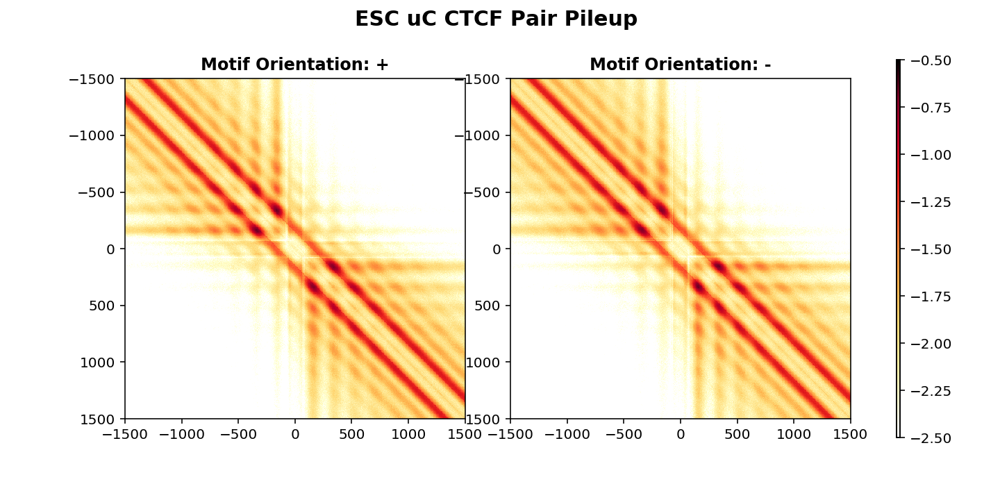

Motif Orientation: +

++
--
+-
-+
-0.6583095734500841
-4.008557591784247
Motif Orientation: -

++
--
+-
-+
-0.6597857449280826
-inf
CTCFL 



<IPython.core.display.Javascript object>


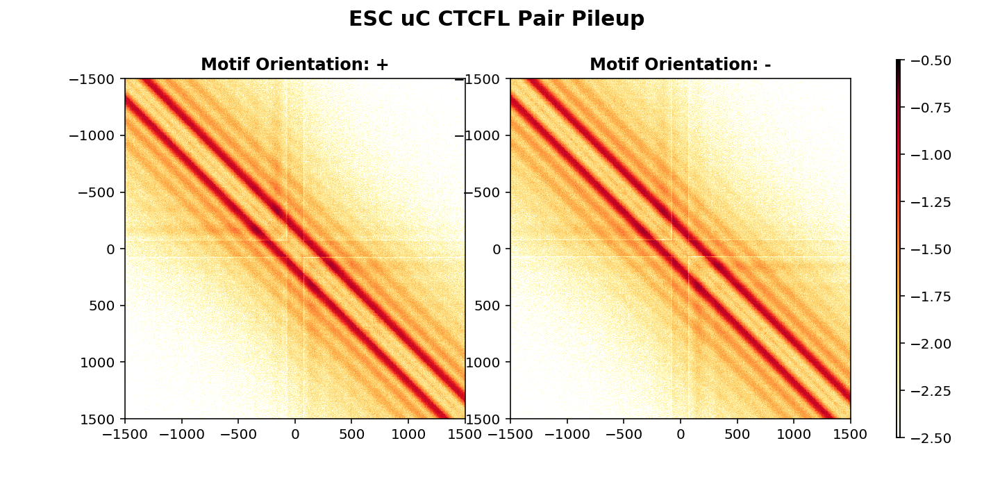

Motif Orientation: +

++
--
+-
-+
-0.737974723658428
-inf
Motif Orientation: -

++
--
+-
-+
-0.7497215019110128
-inf
E2F6 



<IPython.core.display.Javascript object>


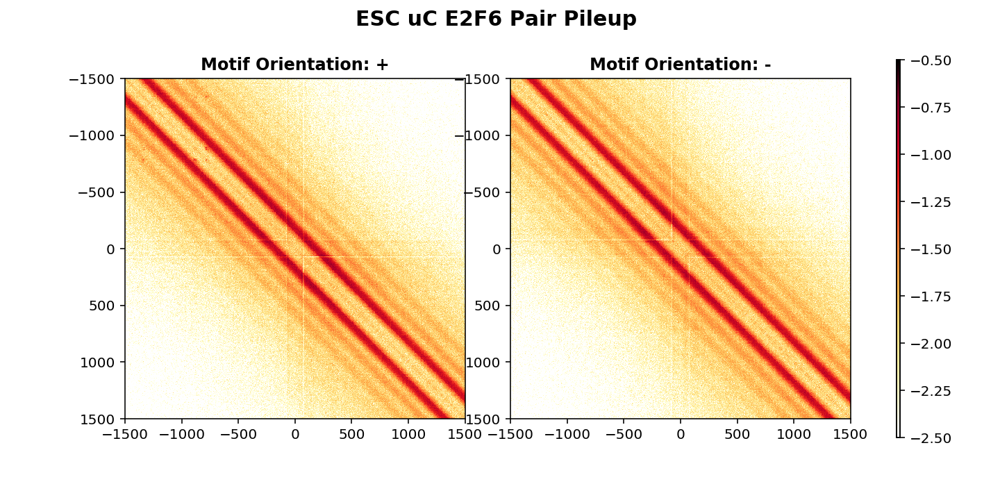

Motif Orientation: +

++
--
+-
-+
-0.7455267750942509
-inf
Motif Orientation: -

++
--
+-
-+
-0.7516763548520218
-inf
EBF1 



<IPython.core.display.Javascript object>


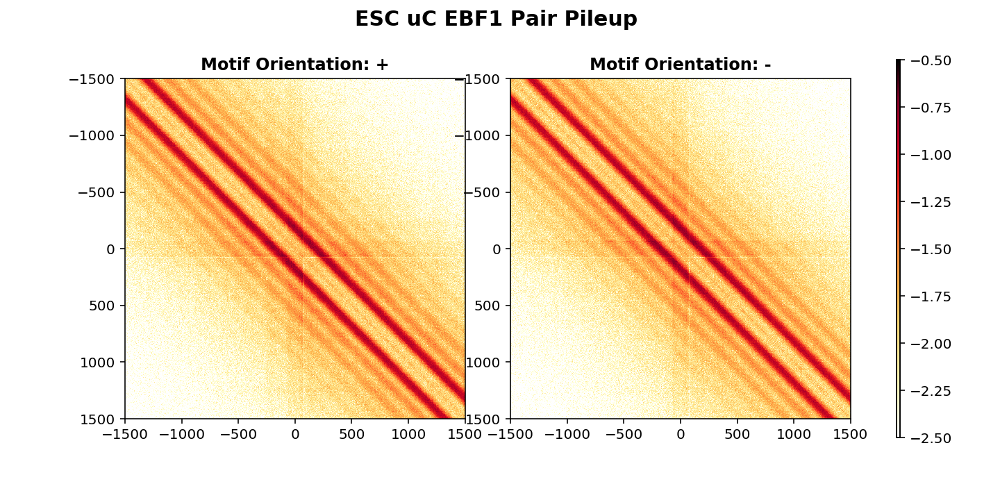

Motif Orientation: +

++
--
+-
-+
-0.6700570704230736
-inf
Motif Orientation: -

++
--
+-
-+
-0.6889736876062779
-inf
EBF3 



<IPython.core.display.Javascript object>


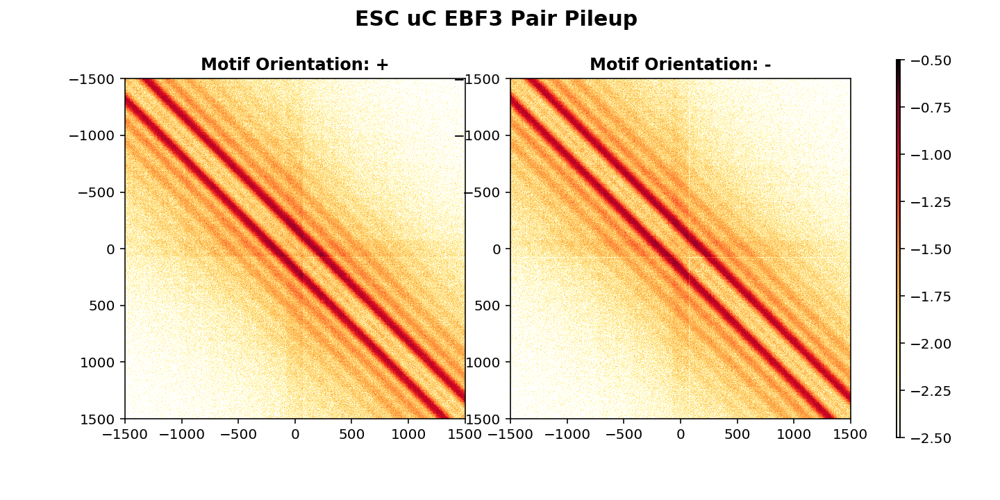

Motif Orientation: +

++
--
+-
-+
-0.6297676438491769
-inf
Motif Orientation: -

++
--
+-
-+
-0.667093586314295
-inf
EGR1 



<IPython.core.display.Javascript object>


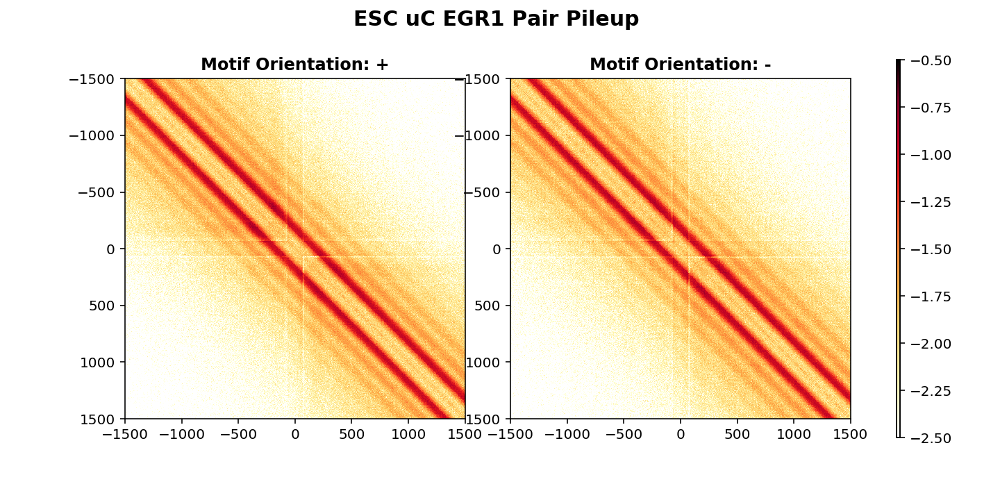

Motif Orientation: +

++
--
+-
-+
-0.7477796635704679
-inf
Motif Orientation: -

++
--
+-
-+
-0.7655738847645269
-inf
KLF15 



<IPython.core.display.Javascript object>


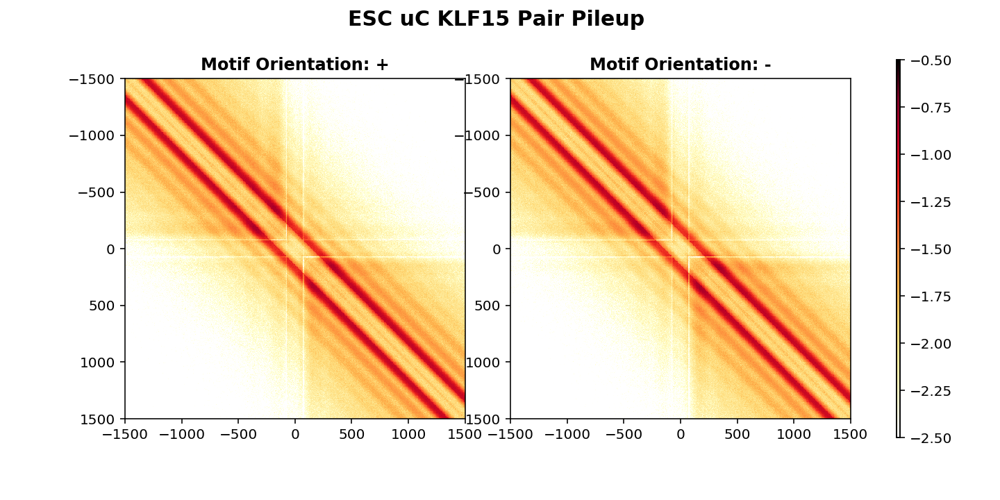

Motif Orientation: +

++
--
+-
-+
-0.7984143078810328
-inf
Motif Orientation: -

++
--
+-
-+
-0.7959422773229509
-inf
KLF17 



<IPython.core.display.Javascript object>


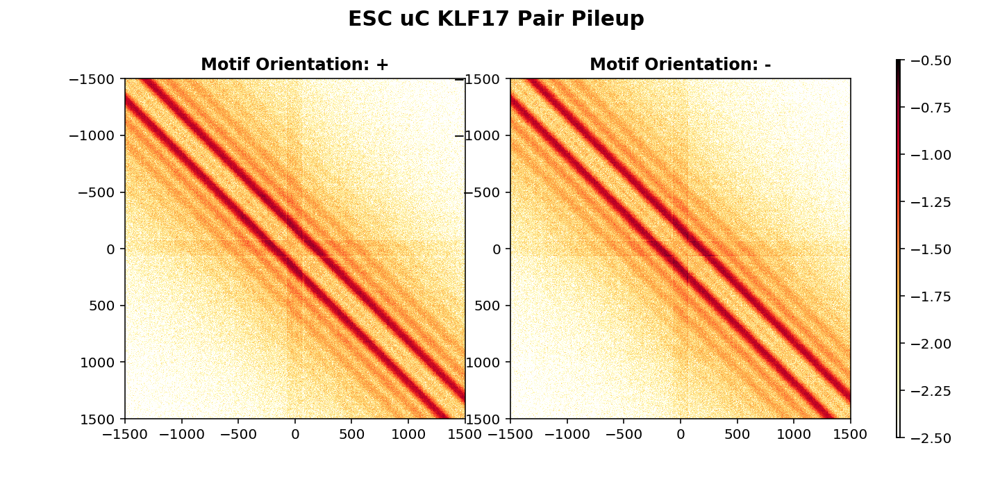

Motif Orientation: +

++
--
+-
-+
-0.6784483371914171
-inf
Motif Orientation: -

++
--
+-
-+
-0.6325630463248229
-inf
KLF4 



<IPython.core.display.Javascript object>


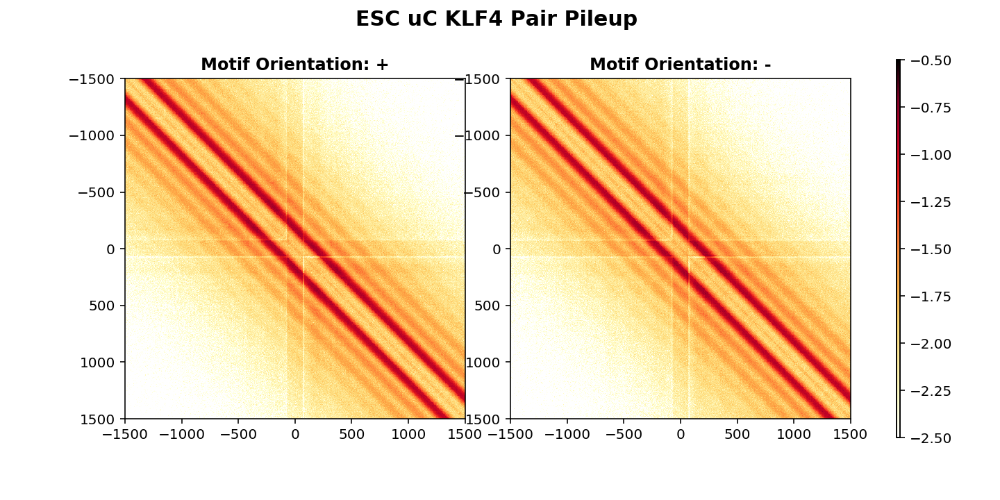

Motif Orientation: +

++
--
+-
-+
-0.7567167949527484
-inf
Motif Orientation: -

++
--
+-
-+
-0.7259900511808551
-inf
KLF5 



<IPython.core.display.Javascript object>


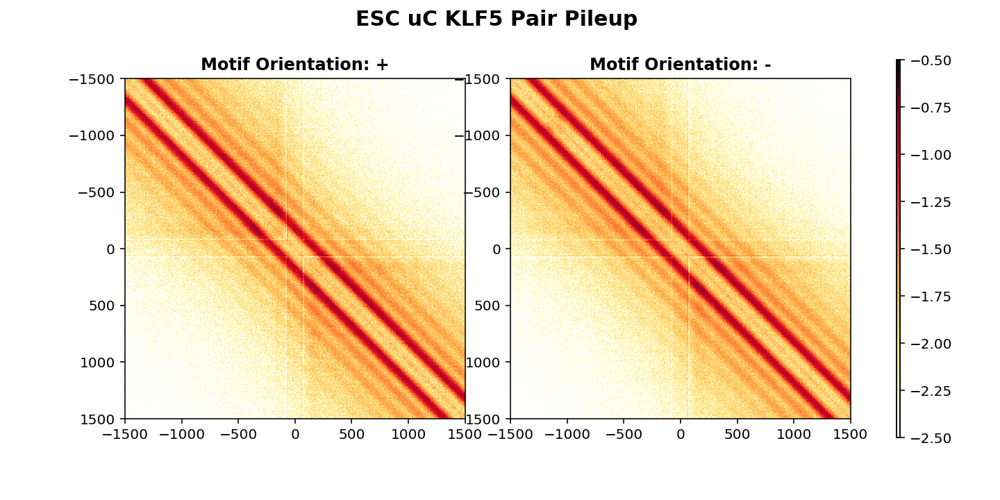

Motif Orientation: +

++
--
+-
-+
-0.7147642715192506
-inf
Motif Orientation: -

++
--
+-
-+
-0.6053879346768899
-inf
KLF9 



<IPython.core.display.Javascript object>


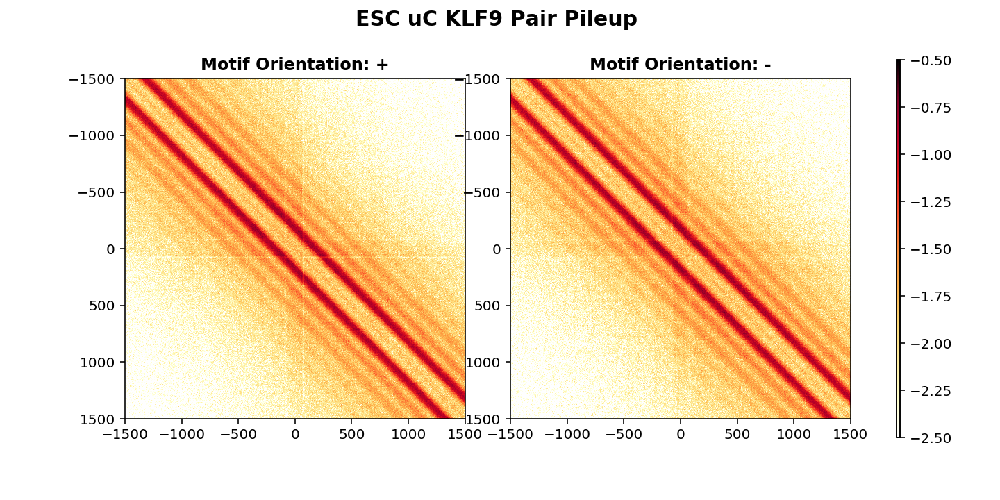

Motif Orientation: +

++
--
+-
-+
-0.7166536474477004
-inf
Motif Orientation: -

++
--
+-
-+
-0.6858861424213507
-inf
MAZ 



<IPython.core.display.Javascript object>


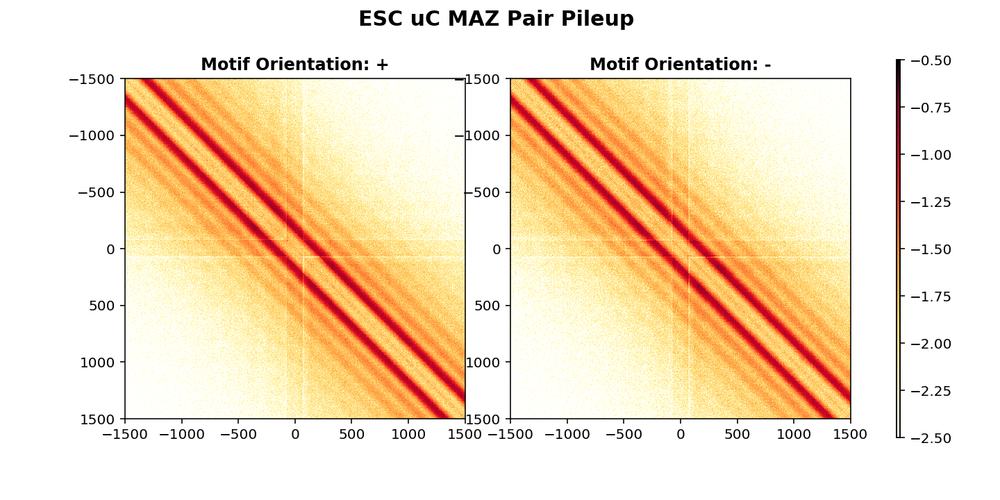

Motif Orientation: +

++
--
+-
-+
-0.7306111221968407
-inf
Motif Orientation: -

++
--
+-
-+
-0.7167897134979979
-inf
MYOG 



<IPython.core.display.Javascript object>


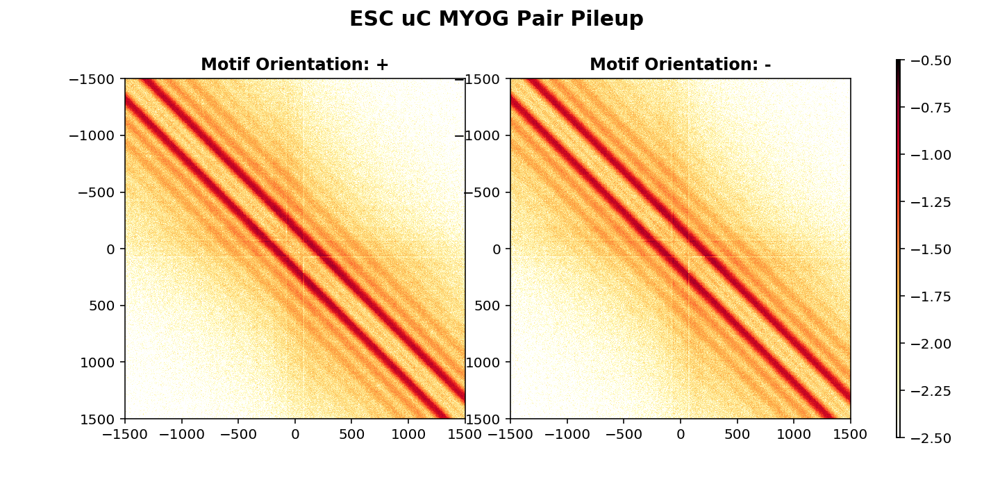

Motif Orientation: +

++
--
+-
-+
-0.7554166292330762
-inf
Motif Orientation: -

++
--
+-
-+
-0.7477569654503119
-inf
MZF1 



<IPython.core.display.Javascript object>


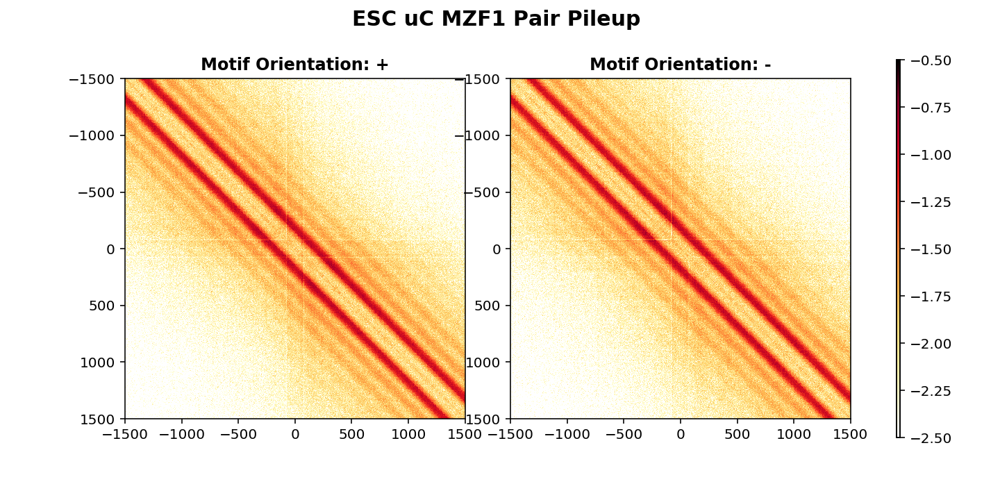

Motif Orientation: +

++
--
+-
-+
-0.7330976408229214
-inf
Motif Orientation: -

++
--
+-
-+
-0.7505969063848021
-inf
NFIB 



<IPython.core.display.Javascript object>


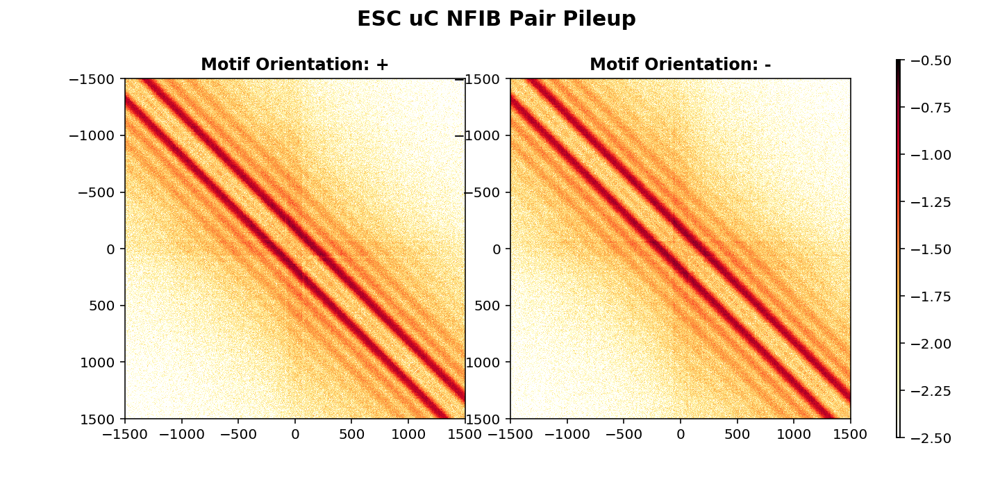

Motif Orientation: +

++
--
+-
-+
-0.6582022533870147
-inf
Motif Orientation: -

++
--
+-
-+
-0.6573079057188417
-inf
NR2C2 



<IPython.core.display.Javascript object>

Motif Orientation: +

++
--
+-
-+
-0.6712570164689864
-inf
Motif Orientation: -

++
--
+-
-+
-0.6540436996403557
-inf
PLAG1 



<IPython.core.display.Javascript object>

Motif Orientation: +

++
--
+-
-+
-0.6438147394349636
-inf
Motif Orientation: -

++
--
+-
-+
-0.6408662554573662
-inf
PLAGL2 



<IPython.core.display.Javascript object>

Motif Orientation: +

++
--
+-
-+
-0.5577503697552109
-inf
Motif Orientation: -

++
--
+-
-+
-0.5569913105578399
-inf
REST 



/home/sameer/miniconda3/lib/python3.6/site-packages/ipykernel_launcher.py:12: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  if sys.path[0] == '':


<IPython.core.display.Javascript object>


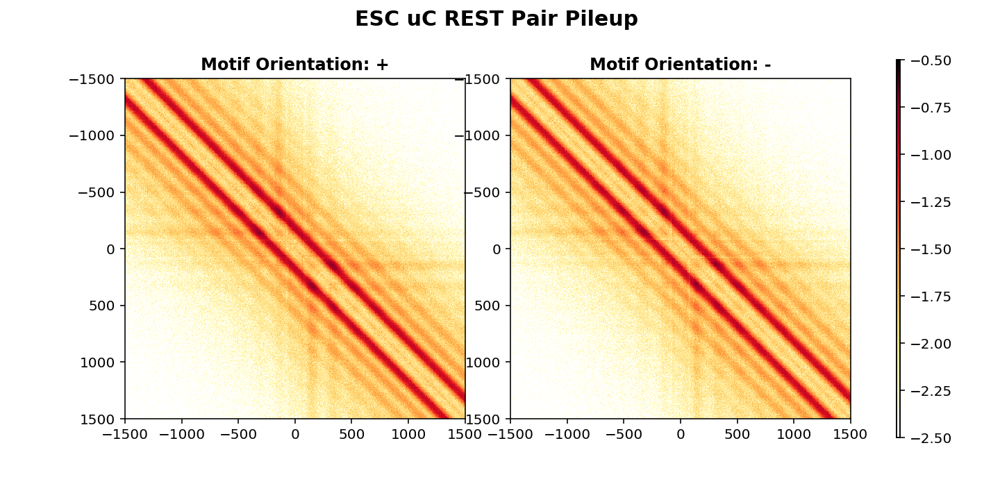

Motif Orientation: +

++
--
+-
-+
-0.6838888195061996
-inf
Motif Orientation: -

++
--
+-
-+
-0.7262470745471677
-inf
RREB1 



<IPython.core.display.Javascript object>


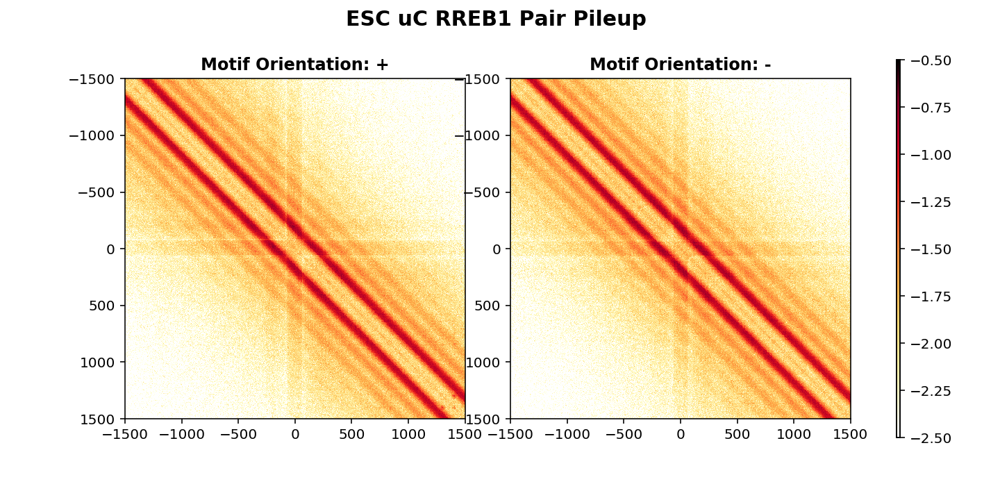

Motif Orientation: +

++
--
+-
-+
-0.72408072491905
-inf
Motif Orientation: -

++
--
+-
-+
-0.7230354363144185
-inf
SP2 



<IPython.core.display.Javascript object>


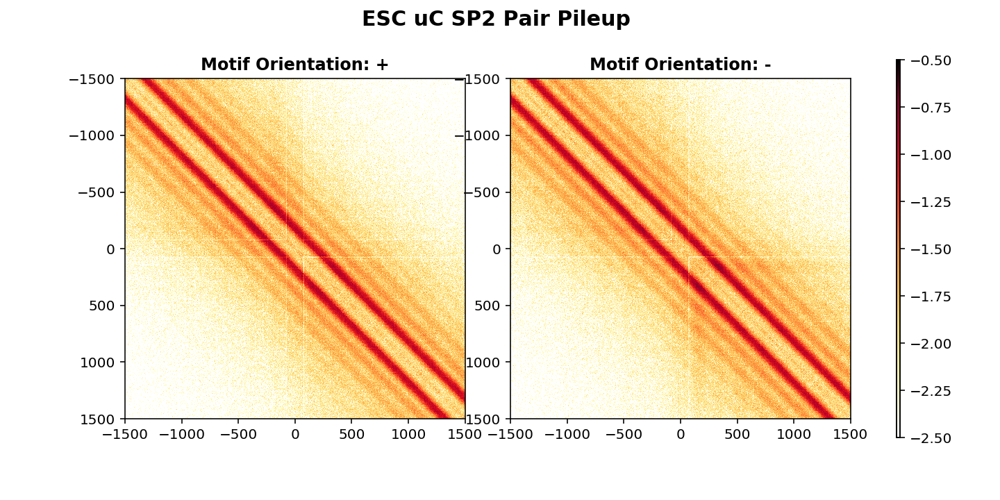

Motif Orientation: +

++
--
+-
-+
-0.7426345053908501
-inf
Motif Orientation: -

++
--
+-
-+
-0.6745392695585366
-inf
SP9 



<IPython.core.display.Javascript object>


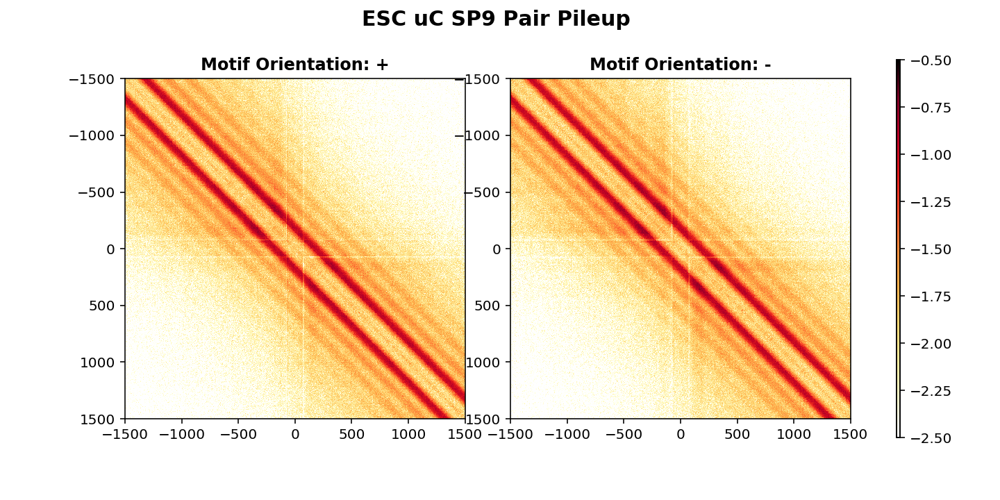

Motif Orientation: +

++
--
+-
-+
-0.7080459415082007
-inf
Motif Orientation: -

++
--
+-
-+
-0.6773537320834744
-inf
TCF4 



<IPython.core.display.Javascript object>


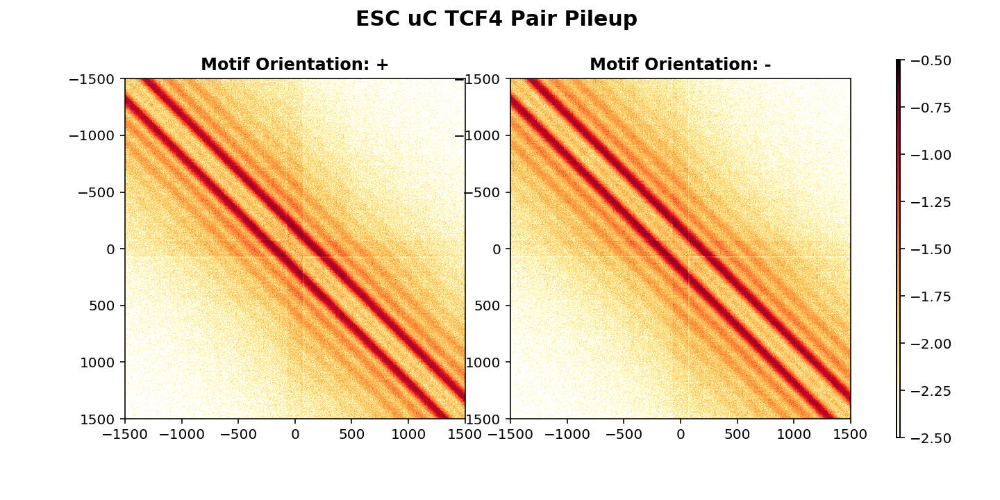

Motif Orientation: +

++
--
+-
-+
-0.6329502043463648
-inf
Motif Orientation: -

++
--
+-
-+
-0.6714330134247015
-inf
TFAP2A 



<IPython.core.display.Javascript object>


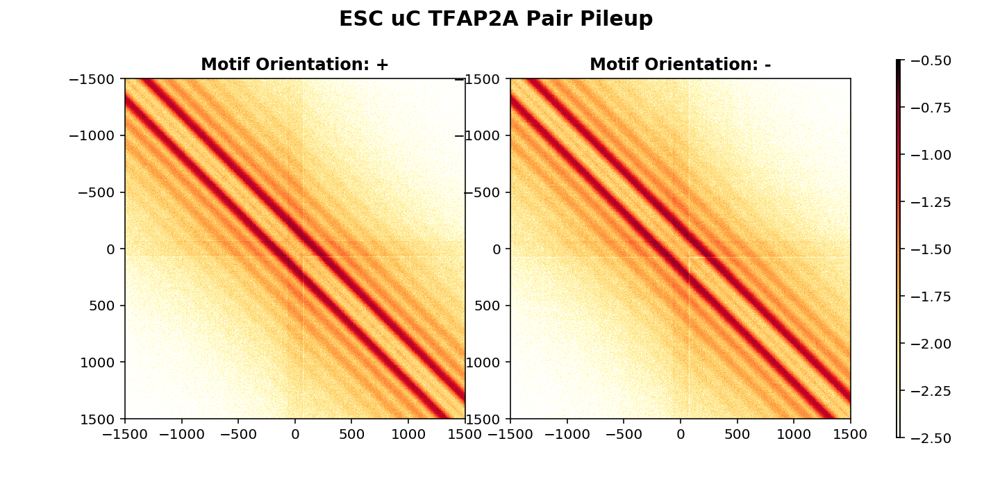

Motif Orientation: +

++
--
+-
-+
-0.6929899514095698
-inf
Motif Orientation: -

++
--
+-
-+
-0.7033296548772304
-inf
TFAP2C 



<IPython.core.display.Javascript object>


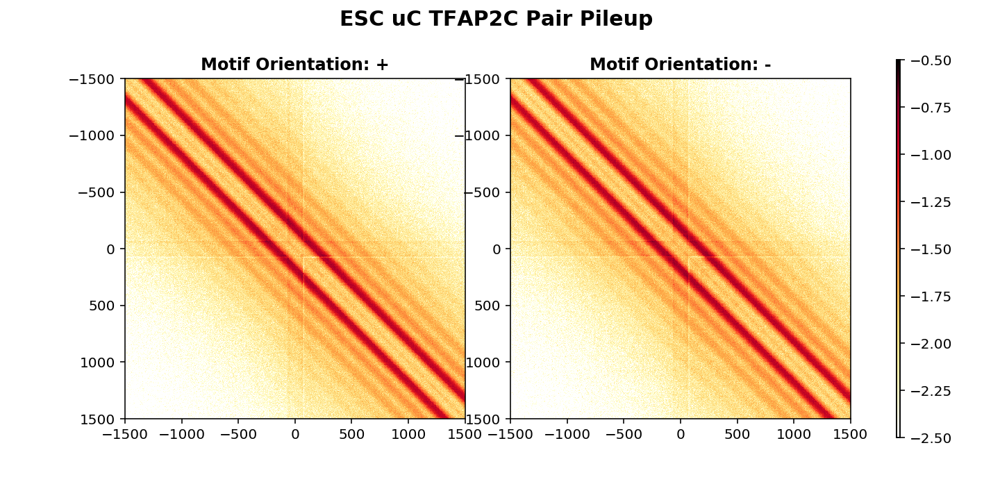

Motif Orientation: +

++
--
+-
-+
-0.6992565727937298
-inf
Motif Orientation: -

++
--
+-
-+
-0.6684098125045762
-inf
THAP11 



<IPython.core.display.Javascript object>


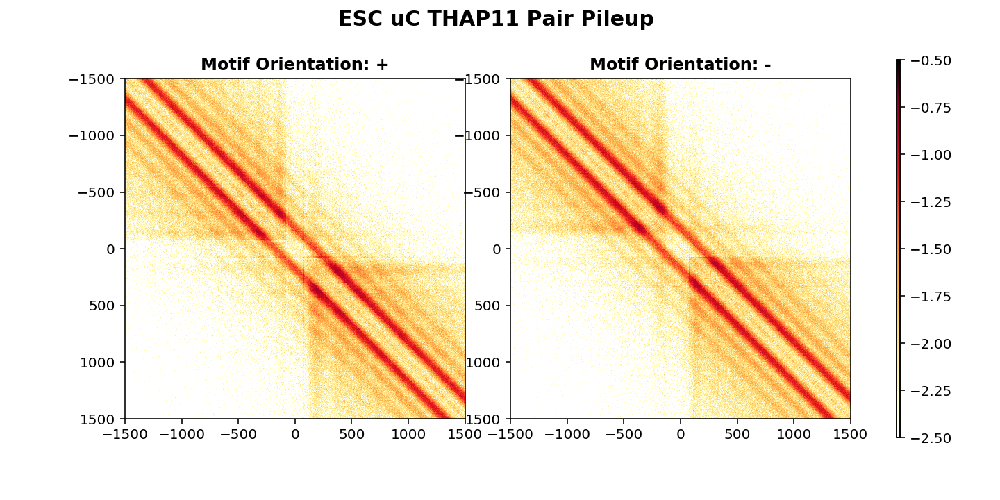

Motif Orientation: +

++
--
+-
-+
-0.7590251118774789
-inf
Motif Orientation: -

++
--
+-
-+
-0.7659989611188784
-inf
ZKSCAN5 



<IPython.core.display.Javascript object>


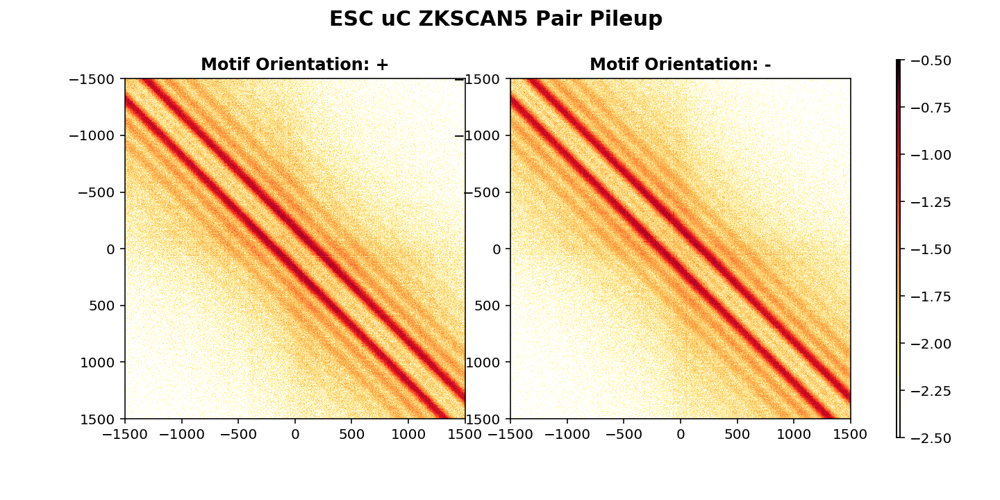

Motif Orientation: +

++
--
+-
-+
-0.7144821705142663
-inf
Motif Orientation: -

++
--
+-
-+
-0.7160033436347991
-inf
ZNF148 



<IPython.core.display.Javascript object>


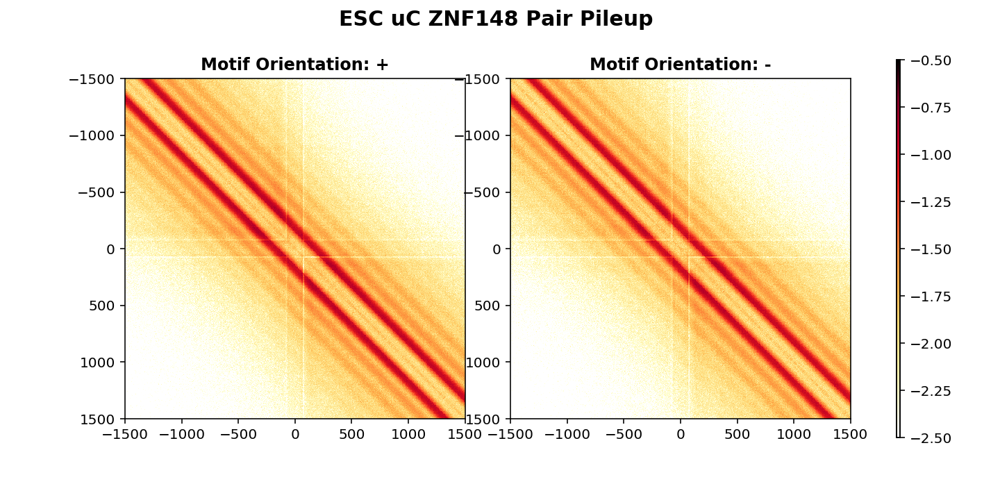

Motif Orientation: +

++
--
+-
-+
-0.7883437660097785
-inf
Motif Orientation: -

++
--
+-
-+
-0.8174901564271279
-inf
ZNF16 



<IPython.core.display.Javascript object>


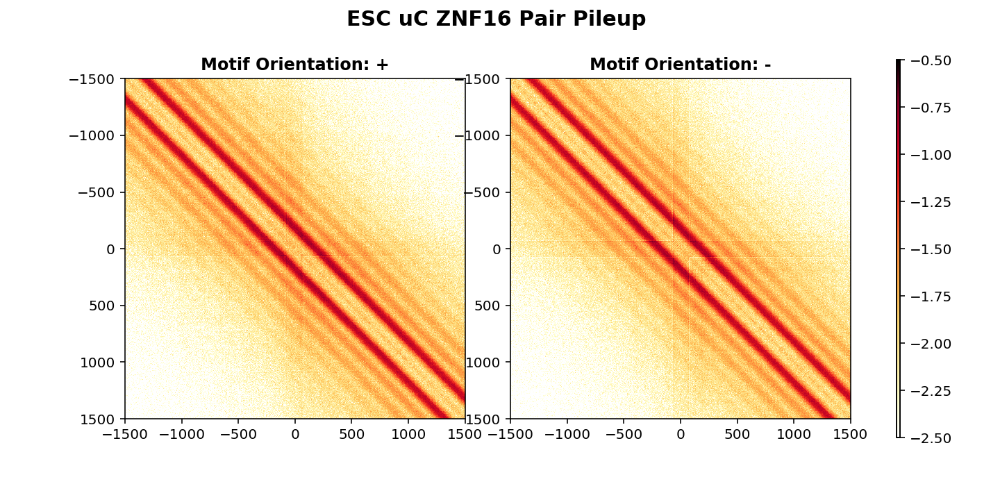

Motif Orientation: +

++
--
+-
-+
-0.7336934877589828
-inf
Motif Orientation: -

++
--
+-
-+
-0.6815085777853239
-inf
ZNF263 



<IPython.core.display.Javascript object>


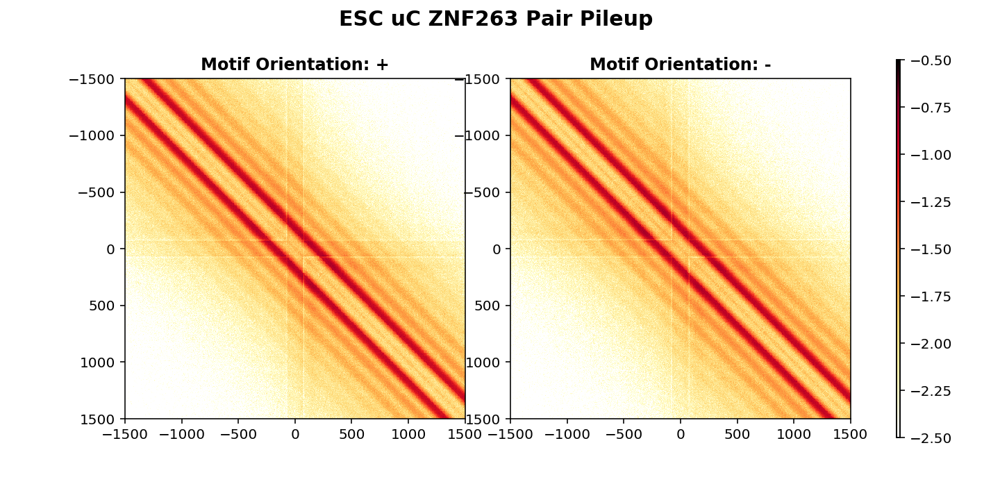

Motif Orientation: +

++
--
+-
-+
-0.7627966307250758
-inf
Motif Orientation: -

++
--
+-
-+
-0.7915260434434627
-inf
ZNF682 



<IPython.core.display.Javascript object>


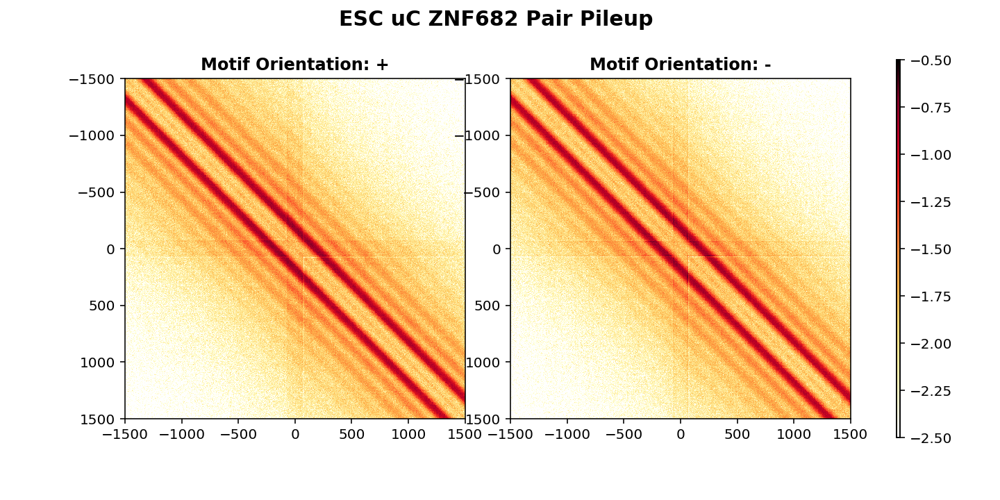

Motif Orientation: +

++
--
+-
-+
-0.6559672574661343
-inf
Motif Orientation: -

++
--
+-
-+
-0.5904138566040819
-inf


In [14]:
# Displaying merged by orientations
factor = 5
pad_bp = 1500
filename = 'U54-H1ESC4DN-FA-DSG-MNase__hg38'
# filename = 'U54-ESC4DN-FA-DpnII-2017524-R1__hg38'

for tf_name in reduced_tf_list:
    print(tf_name, '\n')
    
    tf_path = f'/net/levsha/share/sameer/U54/microc/pileups/pairs/dhs_motifs/{tf_name}/on_diagonal/'
    gs = GridSpec(nrows=1, ncols=3, width_ratios=[90, 90, 1])
    fig = plt.figure(figsize=(10,5))
    fig.suptitle(f'ESC uC {tf_name} Pair Pileup ', fontweight='bold', fontsize=15)
    
    for i, motif_orient in enumerate(['+', '-']):
        print(f'Motif Orientation: {motif_orient}\n')

        path = f'{tf_path}motif_{motif_orient}/'
        site_list = pd.read_csv(f'{path}motif_sites.txt', sep='\t')

        for j, read_orient in enumerate(['++','--','+-','-+']):
            print(read_orient)
            pu = sp.load_npz(path+f'{filename}_{read_orient}.npz')
            arr = pu[0:-1,0:-1].toarray()/site_list.shape[0]


            arr = extend_2d(arr, 73, read_orient)
            arr = arr + arr.T

            if not j:
                tot = arr
            else:
                tot+= arr

        sub_tot = np.log10(coarsen_and_slice(tot, factor, pad_bp))

        print(np.nanmax(sub_tot))
        print(np.nanmin(sub_tot))


        ax = fig.add_subplot(gs[i])
        ax.set_title(f'Motif Orientation: {motif_orient}', fontweight='bold')
        ax.grid([])

        img = ax.imshow(sub_tot, cmap='fall', vmax=-0.5, vmin=-2.5, 
                       extent=[-pad_bp, pad_bp, pad_bp, -pad_bp])

        cax = plt.subplot(gs[2])
        plt.colorbar(img, cax=cax)

    fig.savefig(f'{tf_path}{tf_name}_pileup.png', format='png')
    

In [ ]:



    


    tot = arr_dict[motif_orient]
    

# savepath = f'/net/levsha/share/sameer/U54/microc/pileups/pairs/dhs_motifs/{tf_name}/on_diagonal/'
# fig.savefig(f'{savepath}{tf_name}_pileup.png')

In [ ]:
import new_scalings
from scipy.ndimage.filters import gaussian_filter1d
minus_one = {'trail':coarse_total[top2[0],0:(20000//factor+top2[0]+1)][::-1],
             'lead':coarse_total[top2[0],(20000//factor+top2[0]):]
            }
plus_one = {'trail':coarse_total[top2[1],0:(20000//factor+top2[1]+1)][::-1],
            'lead':coarse_total[top2[1],(20000//factor+top2[1]):]
           }
for key in minus_one.keys():
    arr = minus_one[key]
    df = pd.DataFrame({'num':np.ones(len(arr)), 
                                   'total':arr,
                                   'dist':factor*np.arange(0, len(arr))}).set_index('dist')
    df = new_scalings.log_binning(df, ratio=1.025)
    mean = np.log10(df['total']/df['num']).values
#     print(mean[1:],mean[0:-1])
    s = np.log10(df.index.values)
    slope = gaussian_filter1d((mean[1:]-mean[0:-1])/(s[1:]-s[0:-1]), 2)
    df = pd.DataFrame({'slope':slope,'dist':(s[1:]-s[0:-1])/2})
    minus_one[key] = df
    
for key in plus_one.keys():
    arr = plus_one[key]
    df = pd.DataFrame({'num':np.ones(len(arr)), 
                                  'total':arr,
                                  'dist':factor*np.arange(0, len(arr))}).set_index('dist')
    df = new_scalings.log_binning(df, ratio=1.025)
    mean = np.log10(df['total']/df['num']).values
    s = np.log10(df.index.values)
    slope = gaussian_filter1d((mean[1:]-mean[0:-1])/(s[1:]-s[0:-1]), 2)
    df = pd.DataFrame({'slope':slope,'dist':(s[1:]-s[0:-1])/2})
    plus_one[key] = df

In [ ]:
minus_one

In [ ]:


fig, ax = plt.subplots(ncols=2)
# ax[0].set_yscale('log')
ax[0].set_xscale('log')
ax[0].set_title('Interactions Away from Loop')
dr='trail'
ax[0].plot(plus_one[dr].index, plus_one[dr]['slope'], 'r', label='+1 Nucleosome')#,
ax[0].plot(minus_one[dr].index, minus_one[dr]['slope'], 'b', label='-1 Nucleosome')#
ax[0].legend()

dr='lead'
# ax[1].set_yscale('log')
ax[1].set_xscale('log')
ax[1].set_title('Interactions Towards Loop')
ax[1].plot(plus_one[dr].index, plus_one[dr]['slope'], 'r', label='+1 Nucleosome')#,
ax[1].plot(minus_one[dr].index, minus_one[dr]['slope'], 'b', label='-1 Nucleosome')#
ax[1].legend()

In [ ]:
from scipy.signal import argrelextrema
arr = total.sum(axis=1)
maxs argrelextrema(arr, np.greater, order=5)
# arr

## Flames by CTCF chip signal levels

In [ ]:
files = ! ls /net/levsha/share/sameer/U54/microc/pairq/*ESC*MNase*
files

In [ ]:
ind = np.sort(np.random.choice(np.arange(thres_flames.shape[0]), size=1321, replace=False))

In [ ]:
savepath = '/net/levsha/share/sameer/U54/microc/pileups/flames/ctcf/pairs/ctcf_convergent_downstream_exp_levels/'
for quant in [0.25, 0.5, 0.75, 0.90]:
    print('\n', quant)
    thres_flames = flames[flames['signal'] >= np.quantile(flames['signal'], quant)]
#     inds = np.sort(np.random.choice(np.arange(thres_flames.shape[0]), size=1321, replace=False))
#     thres_flames = thres_flames.iloc[inds]
    
    binned_df = snipping.make_bin_aligned_windows(1, thres_flames['chrom'].values, 
                                               thres_flames['pos'].values, flank_bp=5000)
    chromsizes = bioframe.fetch_chromsizes('hg38')
    chromosomes = list(chromsizes[:'chr22'].index)
    supports = [(chrom, 0, chromsizes[chrom]) for chrom in chromosomes]
    features = snipping.assign_regions(binned_df, supports).dropna()
    assert np.all(features['region'].apply(lambda x: isinstance(x, str)))
    
    for i, orient in enumerate(['++','--','+-','-+']):
        pile = sp.csr_matrix((10001, 10001))

        for file in files:
            print('\n'+file)
            snipper = PairsSnipper(file, strands=orient)

            with mp.Pool(20) as p:
                out = snipping.pileup(features, snipper.select, snipper.snip, map=p.map)

            S = sum(out.squeeze().tolist())
            pile += S
    
        savename = f'U54-H1ESC4DN-FA-DSG-MNase__hg38_{orient}_{quant}.npz'
        sp.save_npz(savepath+savename, pile)
        print(f'SAVED TO: {savepath+savename}')

In [ ]:
# Displaying pilups by chip signal thresholds

savepath = '/net/levsha/share/sameer/U54/microc/pileups/flames/ctcf/pairs/ctcf_convergent_downstream_exp_levels/'
arr_dict = {}
for i, thres in enumerate([0.25,0.5,0.75,0.9]):
    print(thres)
    for i, orient in enumerate(['++','--','+-','-+']):
        print(orient)
        pu = sp.load_npz(savepath+f'U54-H1ESC4DN-FA-DSG-MNase__hg38_{orient}_{thres}.npz')
        arr = pu[0:-1,0:-1].toarray()
        arr = extend_2d(arr, 73, orient)
        arr = arr + arr.T

        if not i:
            total = arr
        else:
            total+= arr
        
    arr_dict[thres] = total
    

In [ ]:
factor = 5
gs = plt.GridSpec(nrows=2,ncols=3, width_ratios=[50,50,1])
fig = plt.figure(figsize=(15,15))
fig.suptitle(f'ESC Micro-C CTCF On Diagonal Pileup \n Convergent Downstream (Coarsening Factor: {factor})', 
             fontweight='bold', fontsize=20)

for i, thres in enumerate([0.25,0.5,0.75,0.9]):
    
    if not i:
        ax = fig.add_subplot(gs[0])
        ax1 = ax
    else:
        ax = fig.add_subplot(gs[i + i//2], sharex=ax1, sharey=ax1)
    ax.grid([])
    
    thres_flames = flames[flames['signal'] >= np.quantile(flames['signal'], thres)]
    
    arr = arr_dict[thres]
    arr = coarsen(np.sum, arr, axes={0:factor, 1:factor})/thres_flames.shape[0]
    arr = np.log10(arr)
    arr[~np.isfinite(arr)] = np.nan
    print(np.nanmax(arr), np.nanmin(arr))
    arr = arr[701:1301, 701:1301]

    img = ax.imshow(arr, cmap='fall', vmax=-0.75, vmin=-3.25,
                    extent=[-1500,1500,-1500,1500])
    ax.set_title(f'Threshold:{thres*100}th%, # Sites:{thres_flames.shape[0]}', fontweight='bold', fontsize=15)
    
cax = fig.add_subplot(gs[:, 2])
plt.colorbar(img, cax=cax)

savepath = './draft_figs/pairs_pileup/on_diagonal_ctcf/'
fig.savefig(f'{savepath}on_diag_ctcf_esc_uc_by_chipseq_levels.pdf', format='pdf')

In [ ]:
# Displaying merged by distance

path = '/net/levsha/share/sameer/U54/microc/pileups/genes/h3k4me3/pairs/'

filename = 'U54-H1ESC4DN-FA-DSG-MNase__hg38'
arr_dict = {}
for i, orient in enumerate(['++','--','+-','-+']):
    print(orient)
    pu = sp.load_npz(path+f'{filename}_{orient}.npz')
    arr = pu[0:-1,0:-1].toarray()/h3k4me3.shape[0]    
    arr_dict[orient] = arr


In [ ]:
gs = plt.GridSpec(nrows=2,ncols=3, width_ratios=[50, 50, 1])
fig = plt.figure()

factor = 10
pad_bp = 1500

fig.suptitle(f'ESC Micro-C H3K4me3 (Coarsening Factor: {factor})', 
             fontweight='bold', fontsize=15)

for i, orient in enumerate(['++','--','+-','-+']):
    print(orient)
    if not i:
        ax = fig.add_subplot(gs[0])
        ax1 = ax
    else:
        ax = fig.add_subplot(gs[i + i//2], sharex=ax1, sharey=ax1)
        
    tot = arr_dict[orient]
    tot = tot + tot.T
    tot = np.log10(coarsen_and_slice(tot, factor, pad_bp))
    
    print(np.nanmax(tot))
    print(np.nanmin(tot))
    img = ax.imshow(tot, cmap='fall', vmax=0, vmin=-2.5, 
                    extent=[-pad_bp, pad_bp, -pad_bp, pad_bp])
    ax.axhline(0, color='k')
    ax.axvline(0, color='k')
    ax.grid([])
    ax.set_title(f'Read Orientation: {orient}', fontweight='bold', fontsize=12)
    
cax = fig.add_subplot(gs[:, 2])
plt.colorbar(img, cax=cax)

# savepath = './draft_figs/pairs_pileup/off_diagonal_ctcf/'
# fig.savefig(f'{savepath}off_diag_ctcf_esc_uc_orients.pdf', format='pdf')
# fig.savefig(f'{savepath}off_diag_ctcf_esc_uc_orients_zoomed.pdf', format='pdf')

In [ ]:
exp_df = gene_quant.merge(annotations, on='gene_id', how='left')
exp_df = exp_df[['name', 'chrom', 'start', 'end', 'strand','TPM']]
exp_df  = exp_df.sort_values(['chrom','start','end'])
exp_df = exp_df.reset_index(drop=True)
exp_df.loc[:, 'length'] = exp_df.loc[:, 'end'] - exp_df.loc[:, 'start']

In [ ]:
pos_genes = exp_df.loc[(exp_df['strand'] == '+')]#(exp_df['length'] > 2500) & 
final_df = pos_genes[pos_genes['TPM'] > np.quantile(pos_genes['TPM'], 0.65)]
final_df

TSS

In [ ]:
binned_df = snipping.make_bin_aligned_windows(1, final_df['chrom'].values, 
                                               final_df['start'].values, flank_bp=5000)
chromsizes = bioframe.fetch_chromsizes('hg38')
chromosomes = list(chromsizes[:'chr22'].index)
supports = [(chrom, 0, chromsizes[chrom]) for chrom in chromosomes]
features = snipping.assign_regions(binned_df, supports).dropna()
assert np.all(features['region'].apply(lambda x: isinstance(x, str)))
features

In [ ]:
files = ! ls /net/levsha/share/sameer/U54/microc/pairq/*ESC*MNase*
files

In [ ]:
savepath = '/net/levsha/share/sameer/U54/microc/pileups/genes/rnaseq/TSS/pairs/downstream_genes/'

for orient in ['++','--','+-','-+']:#
    print('\n'+orient)
    pile = sp.csr_matrix((10001, 10001))
    for file in files:
        print('\n'+file)
        snipper = PairsSnipper(file, strands=orient)

        with mp.Pool(20) as p:
            out = snipping.pileup(features, snipper.select, snipper.snip, map=p.map)

        S = sum(out.squeeze().tolist())
        pile += S
    
    savename = f'U54-H1ESC4DN-FA-DSG-MNase__hg38_{orient}.npz'
    sp.save_npz(savepath+savename, pile)
    print(f'SAVED TO: {savepath+savename}')
#     break

In [ ]:
# Orientations
savepath = '/net/levsha/share/sameer/U54/microc/pileups/genes/rnaseq/TSS/pairs/downstream_genes/'
arr_dict = {}
for i, orient in enumerate(['++','--','+-','-+']):
    print(orient)

    pu = sp.load_npz(savepath+f'U54-H1ESC4DN-FA-DSG-MNase__hg38_{orient}.npz')
    arr = pu[0:-1,0:-1].toarray()
    arr = arr + arr.T
    arr_dict[orient] = arr

In [ ]:
factor = 5
gs = plt.GridSpec(nrows=2,ncols=3, width_ratios=[50,50,1])
fig = plt.figure(figsize=(20,20))
fig.suptitle(f'ESC Micro-C Gene Starts Pileup Downstream \nCoarsening Factor: {factor}', 
             fontweight='bold', fontsize=20)

for i, orient in enumerate(['++','--','+-','-+']):
    print(orient)
    
    if not i:
        ax = fig.add_subplot(gs[0])
        ax1 = ax
    else:
        ax = fig.add_subplot(gs[i + i//2], sharex=ax1, sharey=ax1)
    ax.grid([])
        
    arr = arr_dict[orient]
    arr = coarsen(np.sum, arr, axes={0:factor, 1:factor})/final_df.shape[0]
    arr = np.log10(arr)
    arr[~np.isfinite(arr)] = np.nanmin(arr)
    print(np.nanmax(arr), np.nanmin(arr))
#     arr = arr[701:1301, 701:1301]

    img = ax.imshow(arr, cmap='fall', vmax=-1.5, vmin=-4.25,
            extent = [-5000, 5000, -5000, 5000])
#             extent = [-1500, 1500, -1500, 1500])
    ax.set_title(f'Read Orientation:{orient}', fontweight='bold', fontsize=15)

cax = fig.add_subplot(gs[:, 2])
plt.colorbar(img, cax=cax)

savepath = './draft_figs/pairs_pileup/gene_starts/'
fig.savefig(f'{savepath}gene_starts_esc_orients.pdf', format='pdf')

In [ ]:
## All Merged
savepath = '/net/levsha/share/sameer/U54/microc/pileups/genes/rnaseq/TSS/pairs/downstream_genes/'
factor = 5
gs = plt.GridSpec(nrows=1,ncols=2, width_ratios=[90,1])
fig = plt.figure(figsize=(15,15))
fig.suptitle(f'ESC Micro-C Gene Starts Pileup Downstream \nCoarsening Factor: {factor}', 
             fontweight='bold', fontsize=20)
ax = fig.add_subplot(gs[0])
ax.grid([])
for i, orient in enumerate(['++','--','+-','-+']):
    print(orient)
    
    pu = sp.load_npz(savepath+f'U54-H1ESC4DN-FA-DSG-MNase__hg38_{orient}.npz')
    arr = pu[0:-1,0:-1].toarray()
    arr = extend_2d(arr, 73, orient)
    arr = arr + arr.T
    arr = coarsen(np.sum, arr, axes={0:factor, 1:factor})
    if not i:
        tot = arr
    else:
        tot+= arr
    
tot = np.log10(tot/final_df.shape[0])
tot[~np.isfinite(tot)] = np.nan
print(np.nanmax(tot), np.nanmin(tot))
tot = tot[701:1301, 701:1301]

img = ax.imshow(tot, cmap='fall', vmax=-1, vmin=-3.75,
#         extent = [-5000, 5000, -5000, 5000])
        extent = [-1500, 1500, -1500, 1500])

cax = fig.add_subplot(gs[1])
plt.colorbar(img, cax=cax)

savepath = './draft_figs/pairs_pileup/gene_starts/'
fig.savefig(f'{savepath}gene_starts_esc_zoomed.pdf', format='pdf')

Pileups by RNAseq levels

In [ ]:
pos_genes = exp_df.loc[(exp_df['strand'] == '+')]#(exp_df['length'] > 2500) & 
pos_genes.iloc[np.argsort(pos_genes['TPM'].values)[::-1]]

In [ ]:
files = ! ls /net/levsha/share/sameer/U54/microc/pairq/*ESC*MNase*
files

In [ ]:
chromsizes = bioframe.fetch_chromsizes('hg38')
chromosomes = list(chromsizes[:'chr22'].index)
supports = [(chrom, 0, chromsizes[chrom]) for chrom in chromosomes]
    
savepath = '/net/levsha/share/sameer/U54/microc/pileups/genes/rnaseq/TSS/pairs/downstream_genes_exp_levels/'

ranks = np.argsort(pos_genes['TPM'].values)[::-1]
for lo, hi in [(0,1000),(1000,2000),(2000,3000),(3000,4000)]:
    print('\n', lo, hi)
    
    rank_range = ranks[lo:hi]
    final_df = pos_genes.iloc[rank_range]
    binned_df = snipping.make_bin_aligned_windows(1, final_df['chrom'].values, 
                                               final_df['start'].values, flank_bp=5000)
    features = snipping.assign_regions(binned_df, supports).dropna()
    assert np.all(features['region'].apply(lambda x: isinstance(x, str)))
    features
    
    pile = sp.csr_matrix((10001, 10001))
    for file in files:
        print('\n'+file)
        snipper = PairsSnipper(file, strands=None)

        with mp.Pool(20) as p:
            out = snipping.pileup(features, snipper.select, snipper.snip, map=p.map)

        S = sum(out.squeeze().tolist())
        pile += S
    
    savename = f'U54-H1ESC4DN-FA-DSG-MNase__hg38_({lo},{hi}).npz'
    sp.save_npz(savepath+savename, pile)
    print(f'SAVED TO: {savepath+savename}')
#     break

In [ ]:
# Orientations
chromsizes = bioframe.fetch_chromsizes('hg38')
chromosomes = list(chromsizes[:'chr22'].index)
supports = [(chrom, 0, chromsizes[chrom]) for chrom in chromosomes]

savepath = '/net/levsha/share/sameer/U54/microc/pileups/genes/rnaseq/TSS/pairs/downstream_genes_exp_levels/'
factor = 5
gs = plt.GridSpec(nrows=2,ncols=3, width_ratios=[50,50,1])
fig = plt.figure(figsize=(15,15))
fig.suptitle(f'ESC Micro-C Gene Starts Pileup Downstream \nCoarsening Factor: {factor}', 
             fontweight='bold', fontsize=20)

ranks = np.argsort(pos_genes['TPM'].values)[::-1]
for i, (lo, hi) in enumerate([(0,1000),(1000,2000),(2000,3000),(3000,4000)]):
    print('\n', lo, hi)
    
    rank_range = ranks[lo:hi]
    final_df = pos_genes.iloc[rank_range]
    features = snipping.assign_regions(final_df, supports).dropna()
    assert np.all(features['region'].apply(lambda x: isinstance(x, str)))
    indices = features.index.values
    avg_exp = np.mean(final_df.loc[indices, 'TPM'])
    if not i:
        ax = fig.add_subplot(gs[0])
        ax1 = ax
    else:
        ax = fig.add_subplot(gs[i + i//2], sharex=ax1, sharey=ax1)
    ax.grid([])

    pu = sp.load_npz(savepath+f'U54-H1ESC4DN-FA-DSG-MNase__hg38_({lo},{hi}).npz')
    arr = pu[0:-1,0:-1].toarray()
    arr = arr + arr.T
    arr = coarsen(np.sum, arr, axes={0:factor, 1:factor})/final_df.shape[0]
    arr = np.log10(arr)
    arr[~np.isfinite(arr)] = np.nan
    print(np.nanmax(arr), np.nanmin(arr))
    arr = arr[701:1301, 701:1301]

    img = ax.imshow(arr, cmap='fall', vmax=-1.25, vmin=-2.75,
#             extent = [-5000, 5000, -5000, 5000])
            extent = [-1500, 1500, -1500, 1500])
    ax.set_title(f'Rank Range:({lo},{hi}), Avg Exp. Lvl:{np.round(avg_exp,2)} TPM', fontweight='bold', fontsize=15)

cax = fig.add_subplot(gs[:, 2])
plt.colorbar(img, cax=cax)

TTS

In [ ]:
binned_df = snipping.make_bin_aligned_windows(1, final_df['chrom'].values, 
                                               final_df['end'].values, flank_bp=5000)
chromsizes = bioframe.fetch_chromsizes('hg38')
chromosomes = list(chromsizes[:'chr22'].index)
supports = [(chrom, 0, chromsizes[chrom]) for chrom in chromosomes]
features = snipping.assign_regions(binned_df, supports).dropna()
assert np.all(features['region'].apply(lambda x: isinstance(x, str)))
features

In [ ]:
files = ! ls /net/levsha/share/sameer/U54/microc/pairq/*ESC*MNase*
files

In [ ]:
savepath = '/net/levsha/share/sameer/U54/microc/pileups/genes/rnaseq/TTS/pairs/downstream_genes/'

for orient in ['++','--','+-','-+']:#
    print('\n'+orient)
    pile = sp.csr_matrix((10001, 10001))
    for file in files:
        print('\n'+file)
        snipper = PairsSnipper(file, strands=orient)

        with mp.Pool(20) as p:
            out = snipping.pileup(features, snipper.select, snipper.snip, map=p.map)

        S = sum(out.squeeze().tolist())
        pile += S
    
    savename = f'U54-H1ESC4DN-FA-DSG-MNase__hg38_{orient}.npz'
    sp.save_npz(savepath+savename, pile)
    print(f'SAVED TO: {savepath+savename}')
#     break

In [ ]:
savepath = '/net/levsha/share/sameer/U54/microc/pileups/genes/rnaseq/TTS/pairs/downstream_genes/'
factor = 5
gs = plt.GridSpec(nrows=2,ncols=3, width_ratios=[50,50,1])
fig = plt.figure(figsize=(15,15))
fig.suptitle(f'ESC Micro-C Gene Ends Pileup Downstream \nCoarsening Factor: {factor}', 
             fontweight='bold', fontsize=20)
for i, orient in enumerate(['++','--','+-','-+']):
    print(orient)
    if not i:
        ax = fig.add_subplot(gs[0])
        ax1 = ax
    else:
        ax = fig.add_subplot(gs[i + i//2], sharex=ax1, sharey=ax1)
    ax.grid([])
    
    pu = sp.load_npz(savepath+f'U54-H1ESC4DN-FA-DSG-MNase__hg38_{orient}.npz')
    arr = pu[0:-1,0:-1].toarray()
    arr = arr + arr.T
    arr = coarsen(np.sum, arr, axes={0:factor, 1:factor})/final_df.shape[0]
    arr = np.log10(arr)
    arr[~np.isfinite(arr)] = np.nan
    print(np.nanmax(arr), np.nanmin(arr))
    arr = arr[701:1301, 701:1301]
    
    img = ax.imshow(arr, cmap='fall', vmax=-1.4, vmin=-3.8,
#             extent = [-5000, 5000, -5000, 5000])
            extent = [-1500, 1500, -1500, 1500])
    ax.set_title(f'Read orientation: {orient}', fontweight='bold', fontsize=15)

cax = fig.add_subplot(gs[:, 2])
plt.colorbar(img, cax=cax)

savepath = './draft_figs/pairs_pileup/gene_ends/'
fig.savefig(f'{savepath}gene_ends_esc_orients_zoomed.pdf', format='pdf')

In [ ]:
savepath = '/net/levsha/share/sameer/U54/microc/pileups/genes/rnaseq/TTS/pairs/downstream_genes/'
factor = 5
gs = plt.GridSpec(nrows=1,ncols=2, width_ratios=[90,1])
fig = plt.figure(figsize=(20,20))
fig.suptitle(f'ESC Micro-C Gene Ends Pileup Downstream \nCoarsening Factor: {factor}', 
             fontweight='bold', fontsize=20)
ax = fig.add_subplot(gs[0])
ax.grid([])
for i, orient in enumerate(['++','--','+-','-+']):
    print(orient)
    pu = sp.load_npz(savepath+f'U54-H1ESC4DN-FA-DSG-MNase__hg38_{orient}.npz')
    arr = pu[0:-1,0:-1].toarray()
    arr = extend_2d(arr, 73, orient)
    arr = arr + arr.T
    arr = coarsen(np.sum, arr, axes={0:factor, 1:factor})
    if not i:
        tot = arr
    else:
        tot+= arr
    
tot = np.log10(tot/final_df.shape[0])
tot[~np.isfinite(tot)] = np.nan
print(np.nanmax(tot), np.nanmin(tot))
tot = tot[701:1301, 701:1301]

img = ax.imshow(tot, cmap='fall', vmax=-1.25, vmin=-3,
#             extent = [-5000, 5000, -5000, 5000])
            extent = [-1500, 1500, -1500, 1500])

cax = fig.add_subplot(gs[1])
plt.colorbar(img, cax=cax)

savepath = './draft_figs/pairs_pileup/gene_ends/'
fig.savefig(f'{savepath}gene_ends_esc_zoomed.pdf', format='pdf')

By Expression Levels

In [ ]:
files = ! ls /net/levsha/share/sameer/U54/microc/pairq/*ESC*MNase*
files

In [ ]:
chromsizes = bioframe.fetch_chromsizes('hg38')
chromosomes = list(chromsizes[:'chr22'].index)
supports = [(chrom, 0, chromsizes[chrom]) for chrom in chromosomes]
    
savepath = '/net/levsha/share/sameer/U54/microc/pileups/genes/rnaseq/TTS/pairs/downstream_genes_exp_levels/'

ranks = np.argsort(pos_genes['TPM'].values)[::-1]
for lo, hi in [(0,1000),(1000,2000),(2000,3000),(3000,4000)]:
    print('\n', lo, hi)
    
    rank_range = ranks[lo:hi]
    final_df = pos_genes.iloc[rank_range]
    binned_df = snipping.make_bin_aligned_windows(1, final_df['chrom'].values, 
                                               final_df['end'].values, flank_bp=5000)
    features = snipping.assign_regions(binned_df, supports).dropna()
    assert np.all(features['region'].apply(lambda x: isinstance(x, str)))
    features
    
    pile = sp.csr_matrix((10001, 10001))
    for file in files:
        print('\n'+file)
        snipper = PairsSnipper(file, strands=None)

        with mp.Pool(20) as p:
            out = snipping.pileup(features, snipper.select, snipper.snip, map=p.map)

        S = sum(out.squeeze().tolist())
        pile += S
    
    savename = f'U54-H1ESC4DN-FA-DSG-MNase__hg38_({lo},{hi}).npz'
    sp.save_npz(savepath+savename, pile)
    print(f'SAVED TO: {savepath+savename}')
#     break

In [ ]:
# Orientations
chromsizes = bioframe.fetch_chromsizes('hg38')
chromosomes = list(chromsizes[:'chr22'].index)
supports = [(chrom, 0, chromsizes[chrom]) for chrom in chromosomes]

savepath = '/net/levsha/share/sameer/U54/microc/pileups/genes/rnaseq/TTS/pairs/downstream_genes_exp_levels/'
factor = 5
gs = plt.GridSpec(nrows=2,ncols=3, width_ratios=[50,50,1])
fig = plt.figure(figsize=(15,15))
fig.suptitle(f'ESC Micro-C Gene Starts Pileup Downstream \nCoarsening Factor: {factor}', 
             fontweight='bold', fontsize=20)

ranks = np.argsort(pos_genes['TPM'].values)[::-1]
for i, (lo, hi) in enumerate([(0,1000),(1000,2000),(2000,3000),(3000,4000)]):
    print('\n', lo, hi)
    
    rank_range = ranks[lo:hi]
    final_df = pos_genes.iloc[rank_range]
    features = snipping.assign_regions(final_df, supports).dropna()
    assert np.all(features['region'].apply(lambda x: isinstance(x, str)))
    indices = features.index.values
    avg_exp = np.mean(final_df.loc[indices, 'TPM'])
    if not i:
        ax = fig.add_subplot(gs[0])
        ax1 = ax
    else:
        ax = fig.add_subplot(gs[i + i//2], sharex=ax1, sharey=ax1)
    ax.grid([])

    pu = sp.load_npz(savepath+f'U54-H1ESC4DN-FA-DSG-MNase__hg38_({lo},{hi}).npz')
    arr = pu[0:-1,0:-1].toarray()
    arr = arr + arr.T
    arr = coarsen(np.sum, arr, axes={0:factor, 1:factor})/final_df.shape[0]
    arr = np.log10(arr)
    arr[~np.isfinite(arr)] = np.nan
    print(np.nanmax(arr), np.nanmin(arr))
    arr = arr[701:1301, 701:1301]

    img = ax.imshow(arr, cmap='fall', vmax=-1.25, vmin=-2.75,
#             extent = [-5000, 5000, -5000, 5000])
            extent = [-1500, 1500, -1500, 1500])
    ax.set_title(f'Rank Range:({lo},{hi}), Avg Exp. Lvl:{np.round(avg_exp,2)} TPM', fontweight='bold', fontsize=15)

cax = fig.add_subplot(gs[:, 2])
plt.colorbar(img, cax=cax)

# Gene Pileups based on H3K4Me3 ChIPseq

In [ ]:
## Using H3K4Me3 chipseq peaks
h3k4me3 = pd.read_csv('./tracks/ChIPseq/h1esc_h3k4me3_encode_bernstein/h1esc_h3k4me3_chipseq_peaks.bed.gz',
                     sep='\t',
                     names=['chrom', 'start', 'end', 'name', 'score','strand','signal','pvalue', 'qvalue','peak'],
           index_col=False)
h3k4me3

In [ ]:
promoter_df = bioframe.tools.intersect(annotations[['name','chrom','start','end','strand']].copy(deep=True), 
                                       h3k4me3[['chrom','start','end','score','signal']].copy(deep=True), 
                                       outer_join=True, suffixes=('_gene','_chip'))
promoter_df = promoter_df.dropna()
promoter_df